<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/attention/ImageCaptionGroup3_Attention_Resnet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Reference (GitHub):- https://github.com/hlamba28/Automatic-Image-Captioning/blob/master/Automatic%20Image%20Captioning.ipynb

In [ ]:
#This notebook is used to generate the model for Attention
#attention + Flickr8 + Resnet50 + 50 Epochs

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:

import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [ ]:
import string
import numpy as np
import pandas as pd
from numpy import array
from pickle import load

from PIL import Image
import pickle
from collections import Counter
import matplotlib.pyplot as plt

import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import keras
import tensorflow as tf
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
# from keras.utils import to_categorical
# from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"
jpgs = os.listdir(image_path)

print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
dir_Flickr_text

'/content/Flickr8k.token.txt'

In [ ]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [ ]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
   col = line.split('\t')
   if len(col) == 1:
       continue
   w = col[0].split("#")
   datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data.filename != '2258277193_586949ec62.jpg.1']
uni_filenames = np.unique(data.filename.values)

data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


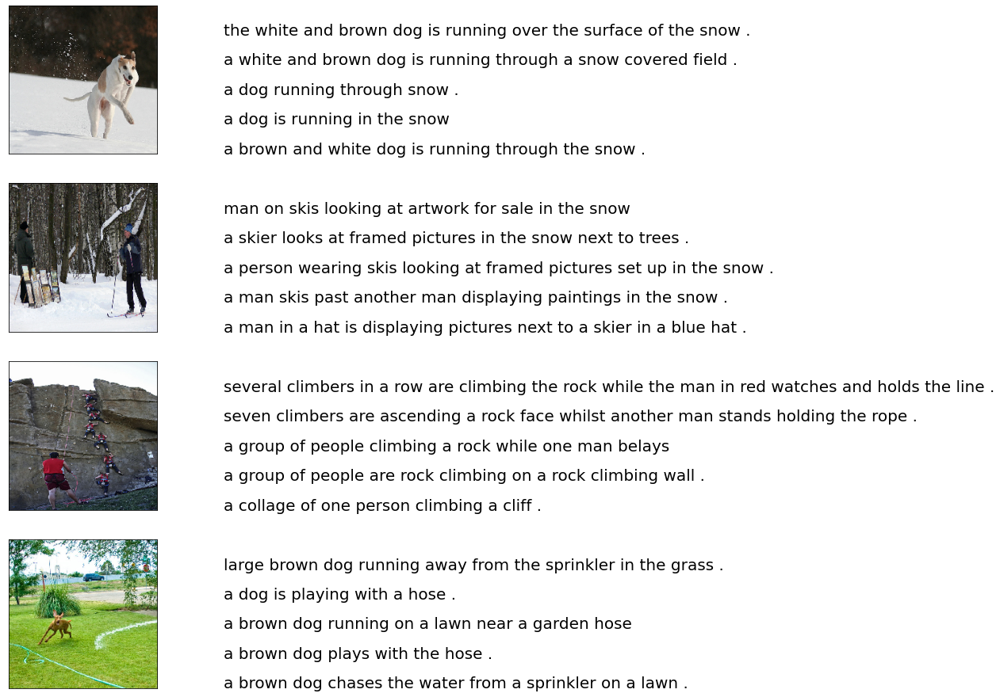

In [ ]:
npic = 5
npix = 224
target_size = (npix,npix,3)  #224,224,3
count = 1

fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:14]:
   filename = image_path + '/' + jpgfnm
   captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
   image_load = load_img(filename, target_size=target_size)
   ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
   ax.imshow(image_load)
   count += 1

   ax = fig.add_subplot(npic,2,count)
   plt.axis('off')
   ax.plot()
   ax.set_xlim(0,1)
   ax.set_ylim(0,len(captions))
   for i, caption in enumerate(captions):
       ax.text(0,i,caption,fontsize=20)
   count += 1
plt.show()

In [ ]:
vocabulary = []
for txt in data.caption.values:
   vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
def remove_punctuation(text_original):
   text_no_punctuation = text_original.translate(string.punctuation)
   return(text_no_punctuation)

def remove_single_character(text):
   text_len_more_than1 = ""
   for word in text.split():
       if len(word) > 1:
           text_len_more_than1 += " " + word
   return(text_len_more_than1)

def remove_numeric(text):
   text_no_numeric = ""
   for word in text.split():
       isalpha = word.isalpha()
       if isalpha:
           text_no_numeric += " " + word
   return(text_no_numeric)

def text_clean(text_original):
   text = remove_punctuation(text_original)
   text = remove_single_character(text)
   text = remove_numeric(text)
   return(text)

for i, caption in enumerate(data.caption.values):
   newcaption = text_clean(caption)
   data["caption"].iloc[i] = newcaption

In [ ]:
clean_vocabulary = []
for txt in data.caption.values:
   clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
PATH = "/content/Flicker8k_Dataset/"
all_captions = []
for caption  in data["caption"].astype(str):
   caption = '<start> ' + caption+ ' <end>'
   all_captions.append(caption)

all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
all_img_name_vector = []
for annot in data["filename"]:
   full_image_path = PATH + annot
   all_img_name_vector.append(full_image_path)

all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
#Clarify
def data_limiter(num,total_captions,all_img_name_vector):
 train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
 train_captions = train_captions[:num]
 img_name_vector = img_name_vector[:num]
 return train_captions,img_name_vector

train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
def load_image(image_path):    
   img = tf.io.read_file(image_path)
   img = tf.image.decode_jpeg(img, channels=3)
   img = tf.image.resize(img, (224, 224))
   print('Shape before preprocess:', img.shape)
   #img = preprocess_input(img)
   print('Shape after preprocess:' , img.shape)

   return img, image_path #224,224,3

#image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")

new_input = image_model.input
hidden_layer = image_model.layers[-2].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

image_features_extract_model.summary()

94781440/94765736 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                             

In [ ]:
image_model_check = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

58900480/58889256 [==============================] - 0s 0us/step


In [ ]:
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


In [ ]:
len(encode_train)

8091

In [ ]:
type(image_dataset)

tensorflow.python.data.ops.dataset_ops.BatchDataset

In [ ]:
for x,y in image_dataset:
    print(x.shape,y.shape)
    break

(64, 224, 224, 3) (64,)


In [ ]:
encode_train[0]

'/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg'

In [ ]:
type(encode_train),type(img_name_vector),type(image_dataset)

(list, list, tensorflow.python.data.ops.dataset_ops.BatchDataset)

In [ ]:
%%time
for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 print(batch_features.shape) #(64, 7, 7, 512)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))
 #print(batch_features.shape)  #(64, 49, 512)
 

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   #print(path_of_feature)
   np.save(path_of_feature, bf.numpy())
 #break

  1%|          | 1/127 [00:09<18:56,  9.02s/it]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


  2%|▏         | 3/127 [00:09<04:38,  2.25s/it]

(64, 7, 7, 2048)


  3%|▎         | 4/127 [00:09<03:00,  1.47s/it]

(64, 7, 7, 2048)


  4%|▍         | 5/127 [00:10<02:07,  1.05s/it]

(64, 7, 7, 2048)


  5%|▍         | 6/127 [00:10<01:35,  1.27it/s]

(64, 7, 7, 2048)


  6%|▌         | 7/127 [00:10<01:13,  1.64it/s]

(64, 7, 7, 2048)


  6%|▋         | 8/127 [00:10<00:58,  2.03it/s]

(64, 7, 7, 2048)


  7%|▋         | 9/127 [00:11<00:48,  2.41it/s]

(64, 7, 7, 2048)


  8%|▊         | 10/127 [00:11<00:44,  2.61it/s]

(64, 7, 7, 2048)


  9%|▊         | 11/127 [00:11<00:40,  2.90it/s]

(64, 7, 7, 2048)


  9%|▉         | 12/127 [00:12<00:36,  3.15it/s]

(64, 7, 7, 2048)


 10%|█         | 13/127 [00:12<00:34,  3.32it/s]

(64, 7, 7, 2048)


 11%|█         | 14/127 [00:12<00:32,  3.49it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 13%|█▎        | 16/127 [00:13<00:31,  3.56it/s]

(64, 7, 7, 2048)


 13%|█▎        | 17/127 [00:13<00:30,  3.65it/s]

(64, 7, 7, 2048)


 14%|█▍        | 18/127 [00:13<00:29,  3.71it/s]

(64, 7, 7, 2048)


 15%|█▍        | 19/127 [00:13<00:28,  3.79it/s]

(64, 7, 7, 2048)


 16%|█▌        | 20/127 [00:14<00:27,  3.91it/s]

(64, 7, 7, 2048)


 17%|█▋        | 21/127 [00:14<00:28,  3.68it/s]

(64, 7, 7, 2048)


 17%|█▋        | 22/127 [00:14<00:28,  3.70it/s]

(64, 7, 7, 2048)


 18%|█▊        | 23/127 [00:14<00:27,  3.78it/s]

(64, 7, 7, 2048)


 19%|█▉        | 24/127 [00:15<00:26,  3.91it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 20%|██        | 26/127 [00:15<00:27,  3.70it/s]

(64, 7, 7, 2048)


 21%|██▏       | 27/127 [00:15<00:25,  3.85it/s]

(64, 7, 7, 2048)


 22%|██▏       | 28/127 [00:16<00:24,  3.98it/s]

(64, 7, 7, 2048)


 23%|██▎       | 29/127 [00:16<00:26,  3.73it/s]

(64, 7, 7, 2048)


 24%|██▎       | 30/127 [00:16<00:26,  3.70it/s]

(64, 7, 7, 2048)


 24%|██▍       | 31/127 [00:17<00:25,  3.80it/s]

(64, 7, 7, 2048)


 25%|██▌       | 32/127 [00:17<00:24,  3.92it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 27%|██▋       | 34/127 [00:17<00:24,  3.83it/s]

(64, 7, 7, 2048)


 28%|██▊       | 35/127 [00:18<00:24,  3.72it/s]

(64, 7, 7, 2048)


 28%|██▊       | 36/127 [00:18<00:23,  3.81it/s]

(64, 7, 7, 2048)


 29%|██▉       | 37/127 [00:18<00:23,  3.90it/s]

(64, 7, 7, 2048)


 30%|██▉       | 38/127 [00:18<00:23,  3.71it/s]

(64, 7, 7, 2048)


 31%|███       | 39/127 [00:19<00:23,  3.72it/s]

(64, 7, 7, 2048)


 31%|███▏      | 40/127 [00:19<00:22,  3.79it/s]

(64, 7, 7, 2048)


 32%|███▏      | 41/127 [00:19<00:22,  3.80it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 34%|███▍      | 43/127 [00:20<00:21,  3.90it/s]

(64, 7, 7, 2048)


 35%|███▍      | 44/127 [00:20<00:22,  3.70it/s]

(64, 7, 7, 2048)


 35%|███▌      | 45/127 [00:20<00:22,  3.60it/s]

(64, 7, 7, 2048)


 36%|███▌      | 46/127 [00:21<00:21,  3.69it/s]

(64, 7, 7, 2048)


 37%|███▋      | 47/127 [00:21<00:21,  3.79it/s]

(64, 7, 7, 2048)


 38%|███▊      | 48/127 [00:21<00:20,  3.93it/s]

(64, 7, 7, 2048)


 39%|███▊      | 49/127 [00:21<00:20,  3.75it/s]

(64, 7, 7, 2048)


 39%|███▉      | 50/127 [00:22<00:20,  3.73it/s]

(64, 7, 7, 2048)


 40%|████      | 51/127 [00:22<00:19,  3.82it/s]

(64, 7, 7, 2048)


 41%|████      | 52/127 [00:22<00:19,  3.91it/s]

(64, 7, 7, 2048)


 42%|████▏     | 53/127 [00:22<00:18,  3.95it/s]

(64, 7, 7, 2048)


 43%|████▎     | 54/127 [00:23<00:19,  3.69it/s]

(64, 7, 7, 2048)


 43%|████▎     | 55/127 [00:23<00:19,  3.76it/s]

(64, 7, 7, 2048)


 44%|████▍     | 56/127 [00:23<00:18,  3.82it/s]

(64, 7, 7, 2048)


 45%|████▍     | 57/127 [00:23<00:19,  3.67it/s]

(64, 7, 7, 2048)


 46%|████▌     | 58/127 [00:24<00:18,  3.68it/s]

(64, 7, 7, 2048)


 46%|████▋     | 59/127 [00:24<00:18,  3.71it/s]

(64, 7, 7, 2048)


 47%|████▋     | 60/127 [00:24<00:17,  3.74it/s]

(64, 7, 7, 2048)


 48%|████▊     | 61/127 [00:24<00:17,  3.81it/s]

(64, 7, 7, 2048)


 49%|████▉     | 62/127 [00:25<00:16,  3.90it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 50%|█████     | 64/127 [00:25<00:16,  3.73it/s]

(64, 7, 7, 2048)


 51%|█████     | 65/127 [00:26<00:16,  3.77it/s]

(64, 7, 7, 2048)


 52%|█████▏    | 66/127 [00:26<00:15,  3.83it/s]

(64, 7, 7, 2048)


 53%|█████▎    | 67/127 [00:26<00:15,  3.83it/s]

(64, 7, 7, 2048)


 54%|█████▎    | 68/127 [00:26<00:16,  3.68it/s]

(64, 7, 7, 2048)


 54%|█████▍    | 69/127 [00:27<00:15,  3.80it/s]

(64, 7, 7, 2048)


 55%|█████▌    | 70/127 [00:27<00:14,  3.89it/s]

(64, 7, 7, 2048)


 56%|█████▌    | 71/127 [00:27<00:14,  3.99it/s]

(64, 7, 7, 2048)


 57%|█████▋    | 72/127 [00:27<00:13,  4.09it/s]

(64, 7, 7, 2048)


 57%|█████▋    | 73/127 [00:28<00:14,  3.70it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 59%|█████▉    | 75/127 [00:28<00:11,  4.40it/s]

(64, 7, 7, 2048)


 60%|█████▉    | 76/127 [00:28<00:14,  3.41it/s]

(64, 7, 7, 2048)


 61%|██████    | 77/127 [00:29<00:14,  3.46it/s]

(64, 7, 7, 2048)


 61%|██████▏   | 78/127 [00:29<00:15,  3.26it/s]

(64, 7, 7, 2048)


 62%|██████▏   | 79/127 [00:29<00:14,  3.43it/s]

(64, 7, 7, 2048)


 63%|██████▎   | 80/127 [00:30<00:13,  3.60it/s]

(64, 7, 7, 2048)


 64%|██████▍   | 81/127 [00:30<00:12,  3.70it/s]

(64, 7, 7, 2048)


 65%|██████▍   | 82/127 [00:30<00:11,  3.76it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 66%|██████▌   | 84/127 [00:31<00:10,  4.00it/s]

(64, 7, 7, 2048)


 67%|██████▋   | 85/127 [00:31<00:10,  3.87it/s]

(64, 7, 7, 2048)


 68%|██████▊   | 86/127 [00:31<00:10,  3.82it/s]

(64, 7, 7, 2048)


 69%|██████▊   | 87/127 [00:31<00:10,  3.83it/s]

(64, 7, 7, 2048)


 69%|██████▉   | 88/127 [00:32<00:09,  3.97it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 71%|███████   | 90/127 [00:32<00:09,  4.06it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 72%|███████▏  | 92/127 [00:33<00:09,  3.52it/s]

(64, 7, 7, 2048)


 73%|███████▎  | 93/127 [00:33<00:09,  3.72it/s]

(64, 7, 7, 2048)


 74%|███████▍  | 94/127 [00:33<00:08,  3.81it/s]

(64, 7, 7, 2048)


 75%|███████▍  | 95/127 [00:34<00:08,  3.62it/s]

(64, 7, 7, 2048)


 76%|███████▌  | 96/127 [00:34<00:08,  3.76it/s]

(64, 7, 7, 2048)


 76%|███████▋  | 97/127 [00:34<00:07,  3.90it/s]

(64, 7, 7, 2048)


 77%|███████▋  | 98/127 [00:34<00:07,  3.87it/s]

(64, 7, 7, 2048)


 78%|███████▊  | 99/127 [00:34<00:06,  4.09it/s]

(64, 7, 7, 2048)


 79%|███████▊  | 100/127 [00:35<00:06,  3.87it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 80%|████████  | 102/127 [00:35<00:06,  3.79it/s]

(64, 7, 7, 2048)


 81%|████████  | 103/127 [00:36<00:06,  3.98it/s]

(64, 7, 7, 2048)


 82%|████████▏ | 104/127 [00:36<00:05,  4.11it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 83%|████████▎ | 106/127 [00:36<00:04,  4.21it/s]

(64, 7, 7, 2048)


 84%|████████▍ | 107/127 [00:37<00:05,  3.72it/s]

(64, 7, 7, 2048)


 85%|████████▌ | 108/127 [00:37<00:07,  2.64it/s]

(64, 7, 7, 2048)


 86%|████████▌ | 109/127 [00:37<00:06,  2.87it/s]

(64, 7, 7, 2048)


 87%|████████▋ | 110/127 [00:38<00:05,  3.10it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 88%|████████▊ | 112/127 [00:38<00:04,  3.34it/s]

(64, 7, 7, 2048)


 89%|████████▉ | 113/127 [00:39<00:03,  3.69it/s]

(64, 7, 7, 2048)


 90%|████████▉ | 114/127 [00:39<00:03,  3.83it/s]

(64, 7, 7, 2048)


 91%|█████████ | 115/127 [00:39<00:03,  3.69it/s]

(64, 7, 7, 2048)


 91%|█████████▏| 116/127 [00:39<00:02,  3.71it/s]

(64, 7, 7, 2048)


 92%|█████████▏| 117/127 [00:40<00:02,  3.66it/s]

(64, 7, 7, 2048)


 93%|█████████▎| 118/127 [00:40<00:02,  3.63it/s]

(64, 7, 7, 2048)


 94%|█████████▎| 119/127 [00:40<00:02,  3.58it/s]

(64, 7, 7, 2048)


 94%|█████████▍| 120/127 [00:40<00:01,  3.64it/s]

(64, 7, 7, 2048)


 95%|█████████▌| 121/127 [00:41<00:01,  3.53it/s]

(64, 7, 7, 2048)


 96%|█████████▌| 122/127 [00:41<00:01,  3.75it/s]

(64, 7, 7, 2048)


 97%|█████████▋| 123/127 [00:41<00:01,  3.76it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 98%|█████████▊| 125/127 [00:42<00:00,  3.36it/s]

(64, 7, 7, 2048)


 99%|█████████▉| 126/127 [00:42<00:00,  3.64it/s]

(64, 7, 7, 2048)


100%|██████████| 127/127 [00:42<00:00,  3.99it/s]

(27, 7, 7, 2048)


100%|██████████| 127/127 [01:21<00:00,  1.55it/s]

CPU times: user 49.9 s, sys: 6.36 s, total: 56.3 s
Wall time: 1min 21s


In [ ]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(train_captions)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
len(cap_vector[0])

33

In [ ]:
def calc_max_length(tensor):
   return max(len(t) for t in tensor)
max_length = calc_max_length(train_seqs)

def calc_min_length(tensor):
   return min(len(t) for t in tensor)
min_length = calc_min_length(train_seqs)

print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 33 : 2


In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,cap_vector, test_size=0.2, random_state=0)

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1
num_steps = len(img_name_train) // BATCH_SIZE
features_shape = 512
attention_features_shape = 49

In [ ]:
#Clarify
def map_func(img_name, cap):
 img_tensor = np.load(img_name.decode('utf-8')+'.npy')
#  print(img_name.decode('utf-8')+'.npy')
#  print(type(img_tensor))
 return img_tensor, cap
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
        map_func, [item1, item2], [tf.float32, tf.int32]),
         num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
img_tensor = np.load('/content/Flicker8k_Dataset/3648988742_888a16f600.jpg.npy')
print(type(img_tensor))

<class 'numpy.ndarray'>


In [ ]:
for x,y in dataset:
    print(x)
    break

tf.Tensor(
[[[0.17471433 0.         0.         ... 0.         0.         0.        ]
  [2.028552   0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.28239444 4.7829027  0.         ... 0.         0.         0.        ]
  [0.         0.25623518 0.         ... 0.         0.         0.        ]
  [0.8327015  0.         0.         ... 0.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.27825826 0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]

 [[0.         0.         0.         ... 4.05945    0.         0.        ]
  [0.      

In [ ]:
class Resnet50_Encoder(tf.keras.Model):
   # This encoder passes the features through a Fully connected layer
   def __init__(self, embedding_dim):
       super(Resnet50_Encoder, self).__init__()
       # shape after fc == (batch_size, 49, embedding_dim)
       self.fc = tf.keras.layers.Dense(embedding_dim)
       self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

   def call(self, x):
       #x= self.dropout(x)
       x = self.fc(x)
       x = tf.nn.relu(x)
       return x   
#We define our RNN based on GPU/CPU capabilities-

def rnn_type(units):
   if tf.test.is_gpu_available():
       return tf.compat.v1.keras.layers.CuDNNLSTM(units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')
   else:
       return tf.keras.layers.GRU(units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_activation='sigmoid',
                                  recurrent_initializer='glorot_uniform')

In [ ]:
encoder = Resnet50_Encoder(embedding_dim)

In [ ]:
#For later
#from torchsummary import summary
#summary(encoder, input_size=(1, 49, 3))

In [ ]:
'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
 def __init__(self, embedding_dim, units, vocab_size):
   super(Rnn_Local_Decoder, self).__init__()
   self.units = units
   self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
   self.gru = tf.keras.layers.GRU(self.units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_initializer='glorot_uniform')
  
   self.fc1 = tf.keras.layers.Dense(self.units)

   self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
   self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

   self.fc2 = tf.keras.layers.Dense(vocab_size)

   # Implementing Attention Mechanism
   self.Uattn = tf.keras.layers.Dense(units)
   self.Wattn = tf.keras.layers.Dense(units)
   self.Vattn = tf.keras.layers.Dense(1)

 def call(self, x, features, hidden):
   # features shape ==> (64,49,256) ==> Output from ENCODER
   # hidden shape == (batch_size, hidden_size) ==>(64,512)
   # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)

   hidden_with_time_axis = tf.expand_dims(hidden, 1)

   # score shape == (64, 49, 1)
   # Attention Function
   '''e(ij) = f(s(t-1),h(j))'''
   ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''

   score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

   # self.Uattn(features) : (64,49,512)
   # self.Wattn(hidden_with_time_axis) : (64,1,512)
   # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
   # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score

   # you get 1 at the last axis because you are applying score to self.Vattn
   # Then find Probability using Softmax
   '''attention_weights(alpha(ij)) = softmax(e(ij))'''

   attention_weights = tf.nn.softmax(score, axis=1)

   # attention_weights shape == (64, 49, 1)
   # Give weights to the different pixels in the image
   ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) '''

   context_vector = attention_weights * features
   context_vector = tf.reduce_sum(context_vector, axis=1)

   # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
   # context_vector shape after sum == (64, 256)
   # x shape after passing through embedding == (64, 1, 256)

   x = self.embedding(x)
   # x shape after concatenation == (64, 1,  512)

   x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
   # passing the concatenated vector to the GRU

   output, state = self.gru(x)
   # shape == (batch_size, max_length, hidden_size)

   x = self.fc1(output)
   # x shape == (batch_size * max_length, hidden_size)

   x = tf.reshape(x, (-1, x.shape[2]))

   # Adding Dropout and BatchNorm Layers
   x= self.dropout(x)
   x= self.batchnormalization(x)

   # output shape == (64 * 512)
   x = self.fc2(x)

   # shape : (64 * 8329(vocab))
   return x, state, attention_weights

 def reset_state(self, batch_size):
   return tf.zeros((batch_size, self.units))


encoder = Resnet50_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [ ]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
   from_logits=True, reduction='none')

def loss_function(real, pred):
 mask = tf.math.logical_not(tf.math.equal(real, 0))
 loss_ = loss_object(real, pred)
 mask = tf.cast(mask, dtype=loss_.dtype)
 loss_ *= mask
 return tf.reduce_mean(loss_)

In [ ]:
[tokenizer.word_index['<start>']] * BATCH_SIZE

[2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2]

In [ ]:
 dec_input1 = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

In [ ]:
dec_input1

<tf.Tensor: shape=(64, 1), dtype=int32, numpy=
array([[2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2]], dtype=int32)>

In [ ]:
dec_input1.shape

TensorShape([64, 1])

In [ ]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
 loss = 0
 # initializing the hidden state for each batch
 # because the captions are not related from image to image

 hidden = decoder.reset_state(batch_size=target.shape[0])
 dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

 with tf.GradientTape() as tape:
     features = encoder(img_tensor)
     for i in range(1, target.shape[1]):
         # passing the features through the decoder
         predictions, hidden, _ = decoder(dec_input, features, hidden)
         loss += loss_function(target[:, i], predictions)

         # using teacher forcing
         dec_input = tf.expand_dims(target[:, i], 1)

 total_loss = (loss / int(target.shape[1]))
 trainable_variables = encoder.trainable_variables + decoder.trainable_variables
 gradients = tape.gradient(loss, trainable_variables)
 optimizer.apply_gradients(zip(gradients, trainable_variables))

 return loss, total_loss

In [ ]:
start_epoch=0

In [ ]:
EPOCHS = 50
for epoch in range(start_epoch, EPOCHS):
   start = time.time()
   total_loss = 0

   for (batch, (img_tensor, target)) in enumerate(dataset):
       batch_loss, t_loss = train_step(img_tensor, target)
       total_loss += t_loss

       if batch % 100 == 0:
           print ('Epoch {} Batch {} Loss {:.4f}'.format(
             epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
   # storing the epoch end loss value to plot later
   loss_plot.append(total_loss / num_steps)

   print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                        total_loss/num_steps))

   print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


Epoch 1 Batch 0 Loss 2.8521
Epoch 1 Batch 100 Loss 1.6159
Epoch 1 Batch 200 Loss 1.4239
Epoch 1 Batch 300 Loss 1.4475
Epoch 1 Batch 400 Loss 1.1354
Epoch 1 Loss 1.488667
Time taken for 1 epoch 100.75199341773987 sec

Epoch 2 Batch 0 Loss 1.1366
Epoch 2 Batch 100 Loss 1.1828
Epoch 2 Batch 200 Loss 1.1406
Epoch 2 Batch 300 Loss 1.0634
Epoch 2 Batch 400 Loss 1.0831
Epoch 2 Loss 1.123657
Time taken for 1 epoch 59.89721608161926 sec

Epoch 3 Batch 0 Loss 1.1482
Epoch 3 Batch 100 Loss 1.1726
Epoch 3 Batch 200 Loss 1.0515
Epoch 3 Batch 300 Loss 1.0191
Epoch 3 Batch 400 Loss 0.9278
Epoch 3 Loss 1.000529
Time taken for 1 epoch 60.9089720249176 sec

Epoch 4 Batch 0 Loss 0.8800
Epoch 4 Batch 100 Loss 0.9179
Epoch 4 Batch 200 Loss 0.9216
Epoch 4 Batch 300 Loss 1.0213
Epoch 4 Batch 400 Loss 0.9627
Epoch 4 Loss 0.915816
Time taken for 1 epoch 61.291717767715454 sec

Epoch 5 Batch 0 Loss 0.8753
Epoch 5 Batch 100 Loss 0.8273
Epoch 5 Batch 200 Loss 0.7921
Epoch 5 Batch 300 Loss 0.8119
Epoch 5 Batch 400

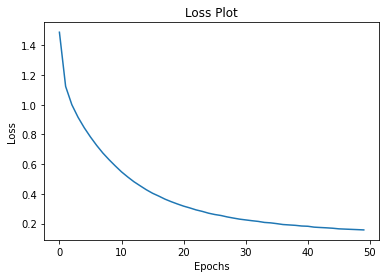

In [ ]:
#Let’s plot the error graph:

plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [ ]:
def evaluate(image):
   attention_plot = np.zeros((max_length, attention_features_shape))

   hidden = decoder.reset_state(batch_size=1)
   temp_input = tf.expand_dims(load_image(image)[0], 0)
   img_tensor_val = image_features_extract_model(temp_input)
   img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
   features = encoder(img_tensor_val)
   dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
   result = []

   for i in range(max_length):
       predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
       attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
       predicted_id = tf.argmax(predictions[0]).numpy()
       result.append(tokenizer.index_word[predicted_id])

       if tokenizer.index_word[predicted_id] == '<end>':
           return result, attention_plot

       dec_input = tf.expand_dims([predicted_id], 0)
   attention_plot = attention_plot[:len(result), :]

   return result, attention_plot

In [ ]:
def plot_attention(image, result, attention_plot):
   temp_image = np.array(Image.open(image))
   fig = plt.figure(figsize=(10, 10))
   len_result = len(result)
   for l in range(len_result):
       temp_att = np.resize(attention_plot[l], (8, 8))
       ax = fig.add_subplot(len_result//2, len_result//2, l+1)
       ax.set_title(result[l])
       img = ax.imshow(temp_image)
       ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

   plt.tight_layout()
   plt.show()

In [ ]:
decoder.save_weights('/content/image_caption_decoder_attention50_resnet50.h5')

In [ ]:
encoder.save_weights('/content/image_caption_encoder_attention50_resnet50.h5')

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 5.75929185611095e-153
Real Caption: Two white dogs are playing in the snow
Prediction Caption: two white dogs run away from different pink nose


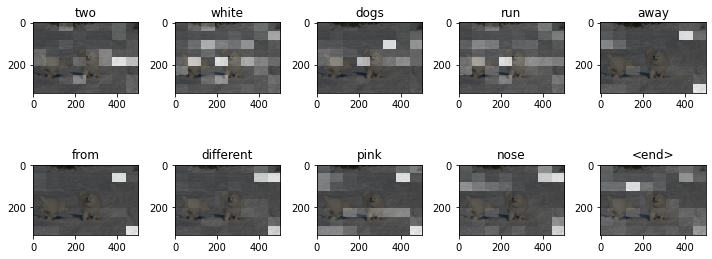

In [ ]:
# captions on the validation set
rid = np.random.randint(0, len(img_name_val))
image = '/content/Flicker8k_Dataset/2319175397_3e586cfaf8.jpg'

# real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
real_caption = 'Two white dogs are playing in the snow'
first = real_caption.split(' ', 1)[1]
real_caption = 'Two white dogs are playing in the snow'

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)
plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
Real Caption: tan dog licks girls hand while laying down
Prediction Caption: the girl with the green scarf and the white dog appear to be playing


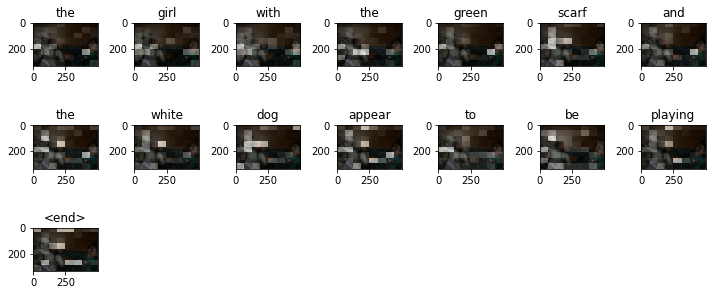

time took to Predict: 2 sec


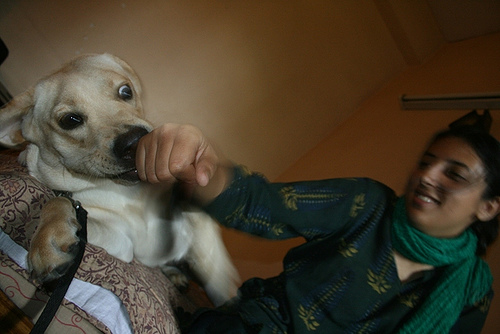

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)
print(f"time took to Predict: {round(time.time()-start)} sec")

Image.open(img_name_val[rid])

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 5.74340400309589e-153
Real Caption: the girl is running on the sand near the beach
Prediction Caption: teenage girl running on beach shouting with an older man walking behind her


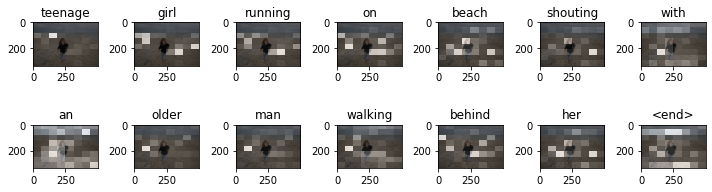

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


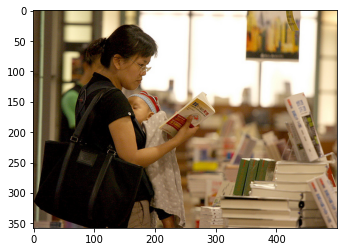

Real Caption: woman wearing black shirt browses through book at store
Prediction Caption: woman looks at the bookstore
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


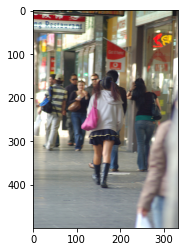

Real Caption: an asian girl carrying pink bag is walking away down busy city street
Prediction Caption: woman wearing blue coat walks past stores
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


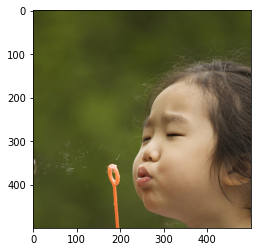

Real Caption: little girl closes her eyes and blows through bubble wand
Prediction Caption: small boy blows through the air
BLEU-1 score: 18.612544500887303
BLEU-2 score: 14.215565675175021
BLEU-3 score: 1.3225476692186996e-91
BLEU-4 score: 4.539324034745998e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


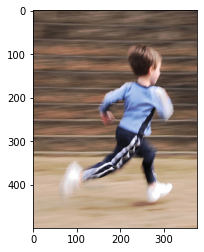

Real Caption: young boy runs
Prediction Caption: little boy running very fast
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


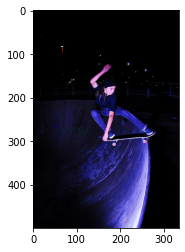

Real Caption: man is skateboarding on ramp in the dark
Prediction Caption: man wearing parachute raised
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


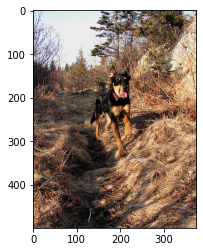

Real Caption: brown and black dog running on trail in the woods
Prediction Caption: dog with red collar runs in forest in the middle of grass
BLEU-1 score: 23.076923076923077
BLEU-2 score: 13.867504905630728
BLEU-3 score: 1.5466866120248002e-91
BLEU-4 score: 5.554837769749797e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


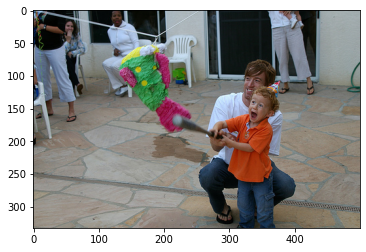

Real Caption: little boy in red shirt is swinging at pinata
Prediction Caption: girl in an orange collared shirt is swinging baseball bat
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


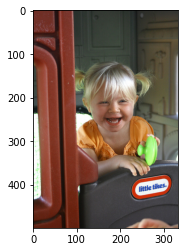

Real Caption: small girl playing in little playground set
Prediction Caption: little little boy is leaning around in front of blue and green toy
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


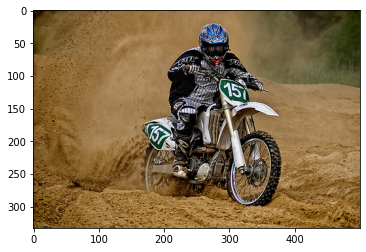

Real Caption: guy on the motorcycle
Prediction Caption: person rides the number dirt bike on sandy track
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


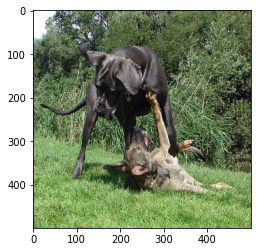

Real Caption: big grey dog wearing chain collar has smaller brown dog pinned down
Prediction Caption: brown dog playing in the grass
BLEU-1 score: 13.986904558770089
BLEU-2 score: 10.682674813114476
BLEU-3 score: 9.938645424274971e-92
BLEU-4 score: 3.4111989380225077e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


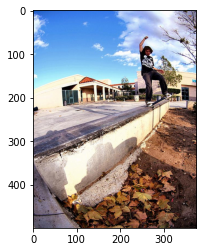

Real Caption: skateboarder attempts trick on the side of low wall
Prediction Caption: boy does trick on his skateboard
BLEU-1 score: 21.470779802151025
BLEU-2 score: 16.39857894551434
BLEU-3 score: 1.5256446952908055e-91
BLEU-4 score: 5.236405306969006e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


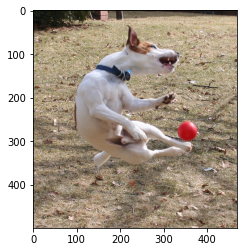

Real Caption: white dog with blue collar plays with red ball
Prediction Caption: the dog is jumping up to catch red ball
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


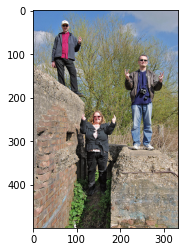

Real Caption: three people posing by brick wall giving signs to the camera
Prediction Caption: two women posing on their way through the hills
BLEU-1 score: 18.096748360719193
BLEU-2 score: 6.036118613529225e-153
BLEU-3 score: 1.4298359405610435e-183
BLEU-4 score: 1.1023928157275092e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


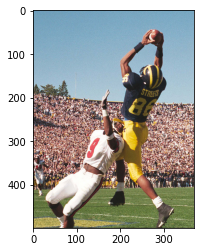

Real Caption: football player in full stadium jumping and recieving football
Prediction Caption: the american footballer in orange outfit half of huge the ball
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


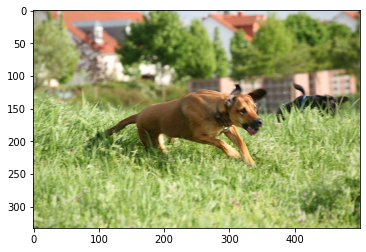

Real Caption: two dogs running through tall grass
Prediction Caption: brown dog races through the grass
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


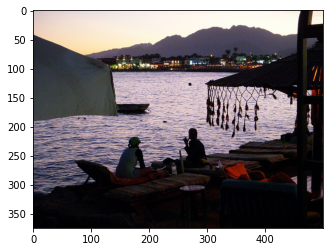

Real Caption: two people sit in the dark on the shore looking at the city lights
Prediction Caption: two people sitting in the shadows near the water
BLEU-1 score: 33.51600230178197
BLEU-2 score: 22.34400153452131
BLEU-3 score: 1.754740031184383e-91
BLEU-4 score: 5.772896823165192e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


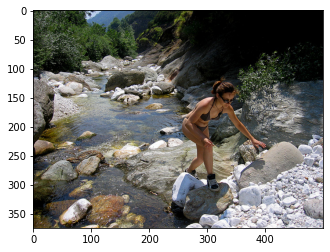

Real Caption: woman in bikini climbs rocks next to rocky stream
Prediction Caption: girl in bikini in background watches
BLEU-1 score: 21.470779802151025
BLEU-2 score: 16.39857894551434
BLEU-3 score: 1.5256446952908055e-91
BLEU-4 score: 5.236405306969006e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


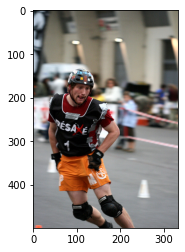

Real Caption: man in orange shorts moving really fast
Prediction Caption: skater goes through course
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


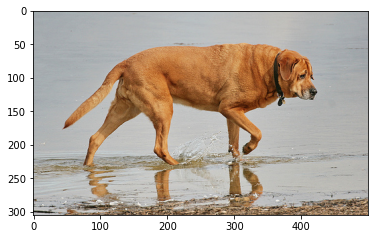

Real Caption: golden haired dog walking through shallow water
Prediction Caption: large brown dog walks on the dock
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


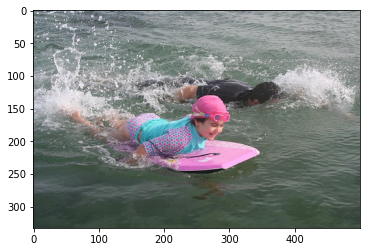

Real Caption: two children splash through the water one is wearing pink swim cap
Prediction Caption: man is falling water on white surfboard
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


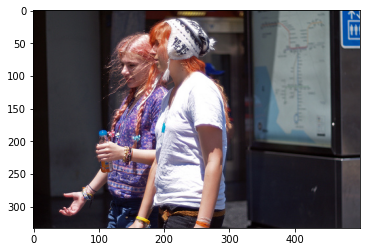

Real Caption: girls with orange hair standing on the street with some kind of bottle in their hand
Prediction Caption: two women playing stand in house
BLEU-1 score: 3.949329237565206
BLEU-2 score: 1.5586355447081413e-153
BLEU-3 score: 3.949104510872758e-184
BLEU-4 score: 3.0963867043779474e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


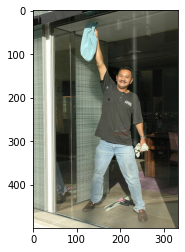

Real Caption: man smiles while he washes windows
Prediction Caption: man standing in big blue building
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


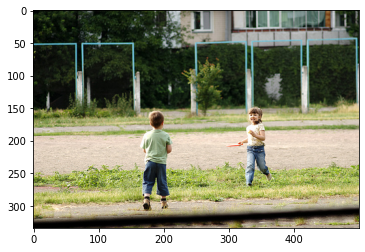

Real Caption: young boy and girl playing
Prediction Caption: young boy and young girl and young girl and young girl and young girl and young girl and young girl and young girl and young girl and young girl and young girl
BLEU-1 score: 12.121212121212123
BLEU-2 score: 8.703882797784892
BLEU-3 score: 8.249342068276574
BLEU-4 score: 1.5270462878358646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


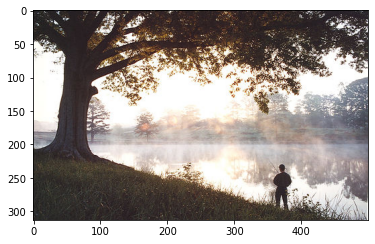

Real Caption: man fishes under large tree
Prediction Caption: man is fishing in the morning mist
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


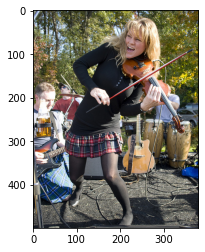

Real Caption: woman in plaid skirt and black top plays an electric violin
Prediction Caption: woman in plaid skirt is holding
BLEU-1 score: 32.26960697187196
BLEU-2 score: 30.18545332364915
BLEU-3 score: 29.459767072902537
BLEU-4 score: 23.217460403031907
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


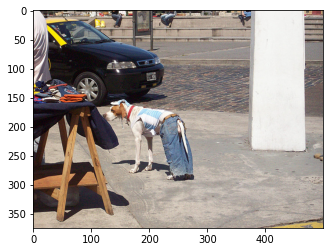

Real Caption: dog wears jeans
Prediction Caption: brown and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


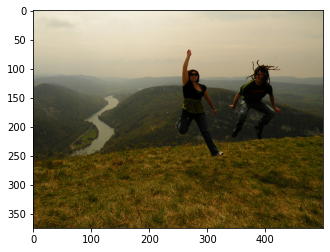

Real Caption: two people jump up and down on cliff overlooking valley
Prediction Caption: two people jump in the grass atop mountain
BLEU-1 score: 29.827977227145652
BLEU-2 score: 25.831786022211855
BLEU-3 score: 23.684339170440293
BLEU-4 score: 3.6100344298273085e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


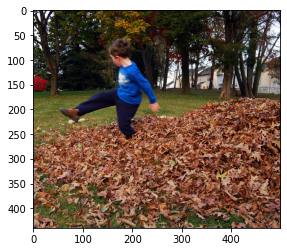

Real Caption: young boy standing with raised leg in large pile of leaves
Prediction Caption: kid in blue shirt is running through pile of leaves
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


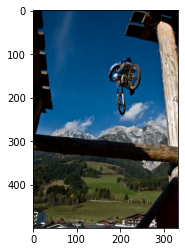

Real Caption: man on motorbike in midair
Prediction Caption: dirt bike in midair
BLEU-1 score: 40.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


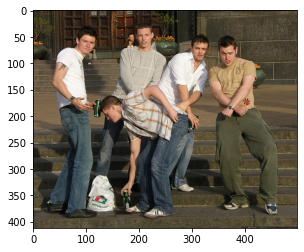

Real Caption: group of young men <unk> around while enjoying beverage
Prediction Caption: five young men and flip flops walks with their arms while the black and black pants and riding bench
BLEU-1 score: 15.0
BLEU-2 score: 8.885233166386385
BLEU-3 score: 1.1841442946899139e-91
BLEU-4 score: 4.446380555605557e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


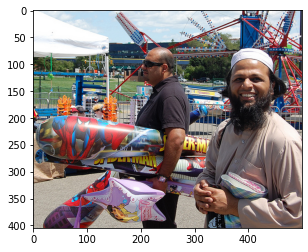

Real Caption: man holding plastic toys looks away while man wearing white hat smiles at the camera
Prediction Caption: two men one with beard at carnival
BLEU-1 score: 5.210775245981356
BLEU-2 score: 2.1984649726039663e-153
BLEU-3 score: 5.721000570633737e-184
BLEU-4 score: 4.515731954963997e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


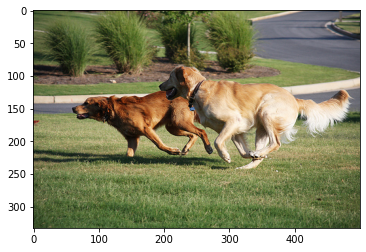

Real Caption: two large dogs running in some grass
Prediction Caption: two large brown dog running through the grass
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


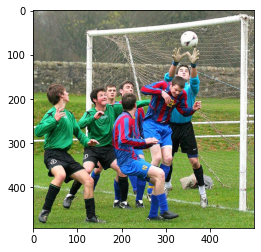

Real Caption: footballers are scrambling around the goal as the goal keeper reaches for the ball
Prediction Caption: goalie tries to catch ball from the goal and the ball
BLEU-1 score: 28.2160574963538
BLEU-2 score: 20.838939520708603
BLEU-3 score: 1.847462928415089e-91
BLEU-4 score: 6.264967407698577e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


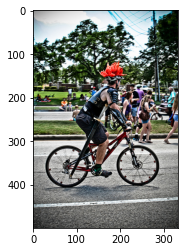

Real Caption: man rides on bicycle as other people walk
Prediction Caption: person is riding bike wearing silver car with several people on the pavement
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


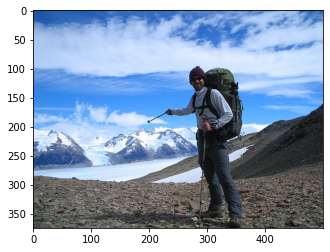

Real Caption: hiker poses for picture in front of stunning mountains and clouds
Prediction Caption: man stands on the ground in the background
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


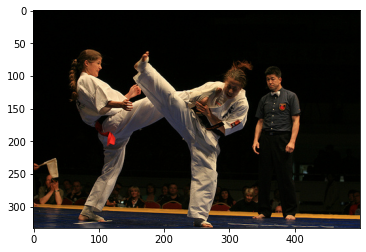

Real Caption: two women in their karate uniforms kick at one another
Prediction Caption: two girls are kicking each other in martial arts
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


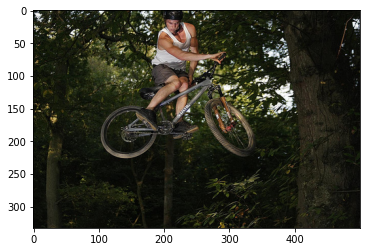

Real Caption: bicyclist doing jumping trick in front of trees
Prediction Caption: man doing bicycle trick surrounded by trees
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


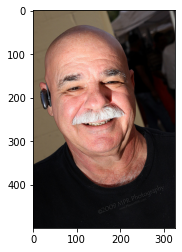

Real Caption: the bald man with the white mustache is wearing <unk> earpiece
Prediction Caption: man in jacket wears green shirt
BLEU-1 score: 8.06740174296799
BLEU-2 score: 3.183867019854334e-153
BLEU-3 score: 8.066942687669913e-184
BLEU-4 score: 6.325072941044999e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


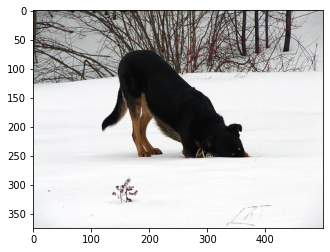

Real Caption: large black dog rubs its face in the snow
Prediction Caption: black dog is digging in the snow
BLEU-1 score: 55.156056411537215
BLEU-2 score: 45.673553902495044
BLEU-3 score: 34.724722537572426
BLEU-4 score: 4.9543569470087646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


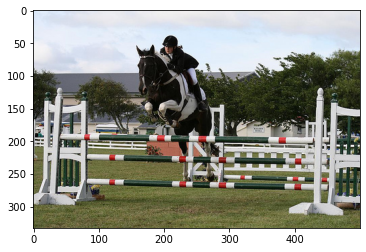

Real Caption: person jumping horse over fence
Prediction Caption: black and horse jumping over striped hurdle
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


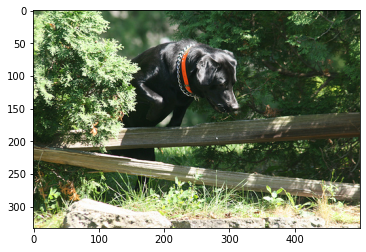

Real Caption: black dog with red collar is climbing over fence posts
Prediction Caption: the black dog is climbing over fence in grassy area
BLEU-1 score: 54.54545454545454
BLEU-2 score: 46.70993664969138
BLEU-3 score: 40.334976925681346
BLEU-4 score: 27.901593935858273
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


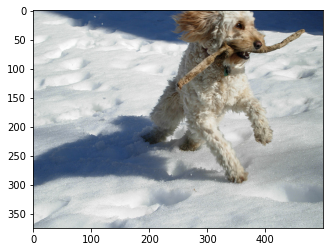

Real Caption: white dog catches stick in the snow
Prediction Caption: tan dog with green jacket is jumping through snow
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


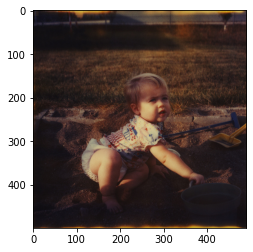

Real Caption: baby is in sandpit playing with bucket
Prediction Caption: toddler in diaper is playing in the middle of water game
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


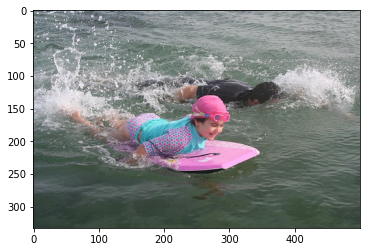

Real Caption: two children splash through the water one is wearing pink swim cap
Prediction Caption: man is falling water on white surfboard
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


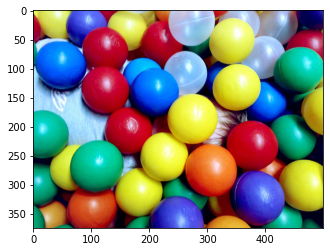

Real Caption: young child partially <unk> by pile of colored balls
Prediction Caption: there are many different colored balls
BLEU-1 score: 21.470779802151025
BLEU-2 score: 16.39857894551434
BLEU-3 score: 1.5256446952908055e-91
BLEU-4 score: 5.236405306969006e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


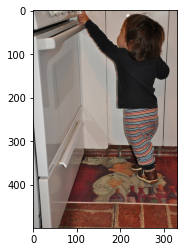

Real Caption: toddler is reaching up to touch stove
Prediction Caption: young boy looking up
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


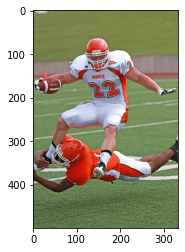

Real Caption: football player in possession of the ball gets tackled by football player on the opposing team
Prediction Caption: male football player in orange and white uniform dodges tackle of another player
BLEU-1 score: 30.959924991077926
BLEU-2 score: 20.319931387183072
BLEU-3 score: 17.225908695598804
BLEU-4 score: 2.75410745309177e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


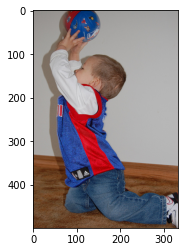

Real Caption: small boy lifts red and blue ball
Prediction Caption: little boy in blue and red ball in his hand
BLEU-1 score: 45.45454545454545
BLEU-2 score: 1.0056824590358316e-152
BLEU-3 score: 2.0215284352902457e-183
BLEU-4 score: 1.4959003140449575e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


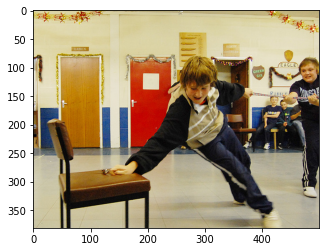

Real Caption: child balances on chair with one arm
Prediction Caption: two boys with blue
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


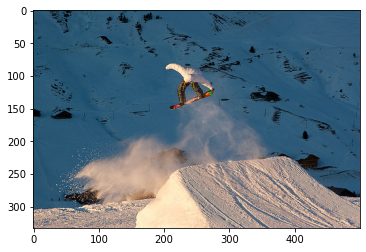

Real Caption: snowboarder in midair hovering over snow ramp
Prediction Caption: snowboarder in midair
BLEU-1 score: 35.427491455576096
BLEU-2 score: 33.40135926488844
BLEU-3 score: 31.164570156314518
BLEU-4 score: 4.079437169260337e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


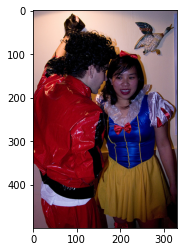

Real Caption: boy and girl are dressed in colorful costumes
Prediction Caption: two people dressed in costumes
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


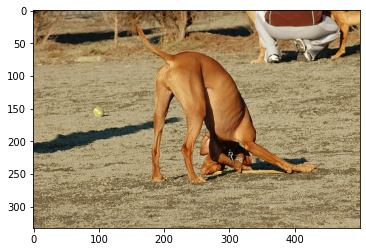

Real Caption: two dogs and person
Prediction Caption: brown dog wearing is playing in the dirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


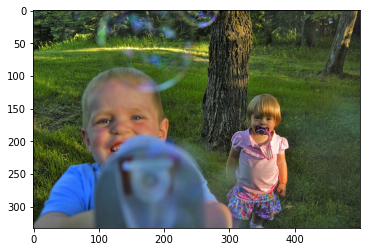

Real Caption: little boy and little girl are playing outside with bubbles
Prediction Caption: boy blowing bubbles into the camera
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


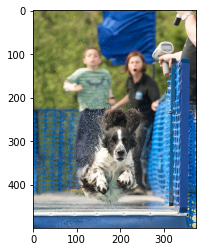

Real Caption: two children watch as dog runs through blue fenced course towards person holding <unk> and microphone
Prediction Caption: wet dog flies through the air while an orange woman in blue runs black dog
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


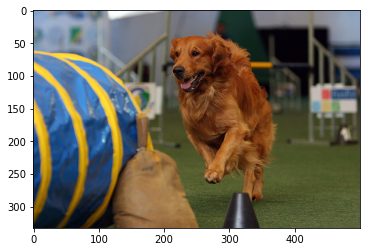

Real Caption: brown dog is in an agility contest and running towards blue tube
Prediction Caption: dog runs toward tunnel
BLEU-1 score: 4.93193927883213
BLEU-2 score: 1.6450342287110981e-153
BLEU-3 score: 3.8967575262557506e-184
BLEU-4 score: 3.0043709069803197e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


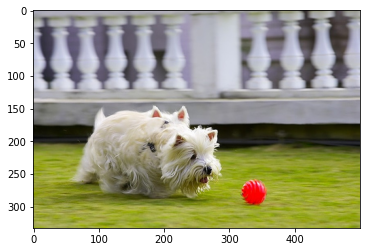

Real Caption: two white dogs chase after red ball in yard in front of white fence
Prediction Caption: two west highland terriers chase red ball
BLEU-1 score: 23.618327637050733
BLEU-2 score: 12.624527152345427
BLEU-3 score: 1.0830389040770212e-91
BLEU-4 score: 3.642665943163536e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


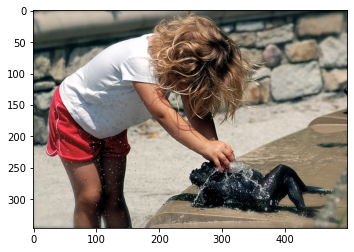

Real Caption: little girl playing in water on frog sculpture
Prediction Caption: the girl is playing with his feet is talking on water fountain that sprays water
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


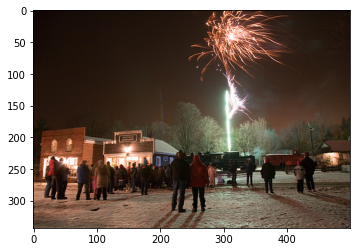

Real Caption: group of people gathered to watch fireworks
Prediction Caption: children watch as march in chinese colors looking at fireworks
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


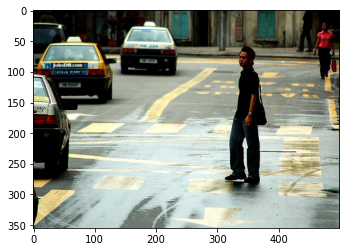

Real Caption: man <unk> in black shirt is waiting to cross the street with traffic
Prediction Caption: man waiting for traffic to stop at road crossing
BLEU-1 score: 29.632728827268718
BLEU-2 score: 6.988981112343731e-153
BLEU-3 score: 1.441240015597435e-183
BLEU-4 score: 1.0733342226651737e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


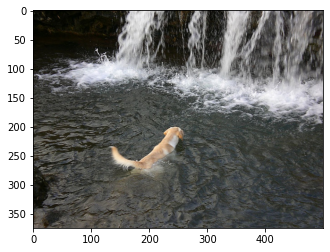

Real Caption: yellow dog swims towards waterfall
Prediction Caption: the dog is jumping into the water toward the waterfall
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


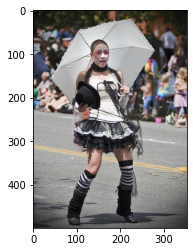

Real Caption: woman with shaved head dressed in black and white in parade
Prediction Caption: woman and woman in the woman in the white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 15.151515151515154
BLEU-2 score: 6.8810235320397535
BLEU-3 score: 1.0157694694037605e-91
BLEU-4 score: 3.912899894057541e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


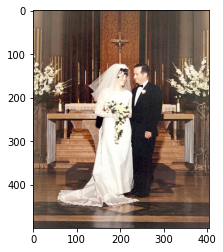

Real Caption: newlyweds smile and pose for picture after their ceremony
Prediction Caption: man and wife stand to church each other while one drinking from fountain
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


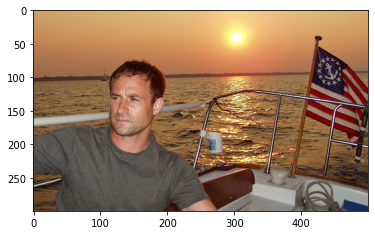

Real Caption: man sits on boat in the sunset near flag
Prediction Caption: man sits on sailboat with the sun setting behind him
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


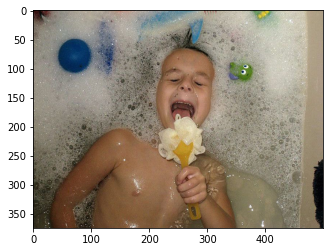

Real Caption: child is laying in bubble bath holding yellow scrubbing brush up to his mouth as if singing into microphone
Prediction Caption: smiling in the bubbles while in bubble splashing in the bubbles while in bubble splashing in the bubbles while in bubble splashing in the bubbles while in bubble splashing in the bubbles
BLEU-1 score: 6.060606060606061
BLEU-2 score: 4.351941398892446
BLEU-3 score: 7.71637193255361e-92
BLEU-4 score: 3.111814750339667e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


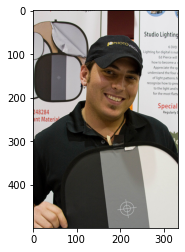

Real Caption: man wearing black shirt and baseball cap smiling
Prediction Caption: man in black shirt black hat and scarf
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


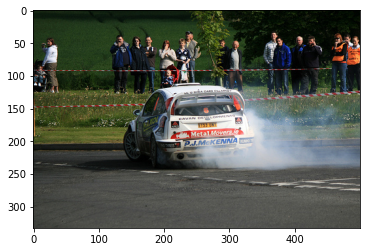

Real Caption: onlookers watch white <unk> car that has smoke coming out of the back
Prediction Caption: race car drives on track while several people watch from behind rope
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


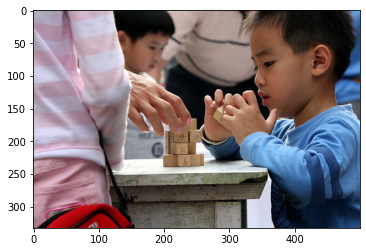

Real Caption: boy in blue shirt looking at someone hand near stack of blocks on table
Prediction Caption: boy plays with blue jacket
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


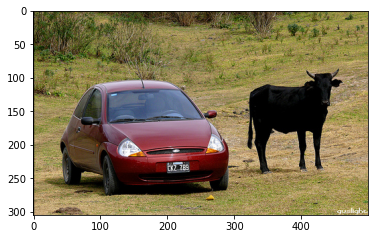

Real Caption: bull stands in field next to red car
Prediction Caption: two people stand next to cow in field
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


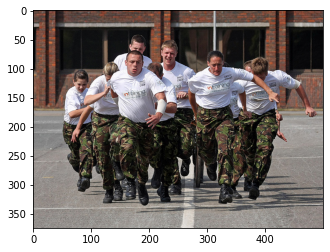

Real Caption: group of men in camouflage pants and white are running in drill yard
Prediction Caption: some african army people in army pants and run race
BLEU-1 score: 22.73871594750492
BLEU-2 score: 13.768976278037112
BLEU-3 score: 1.4320535796734358e-91
BLEU-4 score: 5.054075496608412e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


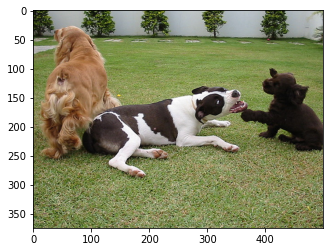

Real Caption: three dogs playing in yard together
Prediction Caption: three dogs play together
BLEU-1 score: 49.12384518467891
BLEU-2 score: 31.709305716988812
BLEU-3 score: 2.3451563965552024e-91
BLEU-4 score: 7.600394483915427e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


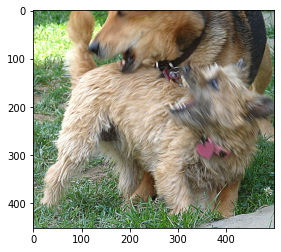

Real Caption: two dogs both wearing collars are playing with one another in the grass
Prediction Caption: two brown dogs fighting each other
BLEU-1 score: 12.124938447912854
BLEU-2 score: 3.3836527003416395e-153
BLEU-3 score: 7.463350408713334e-184
BLEU-4 score: 5.652478243478208e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


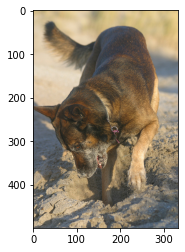

Real Caption: dog digs in sand
Prediction Caption: large brown dog is digging in the sand
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


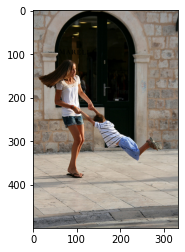

Real Caption: woman swinging boy in circle
Prediction Caption: young boy is leaping in front of the side by building
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


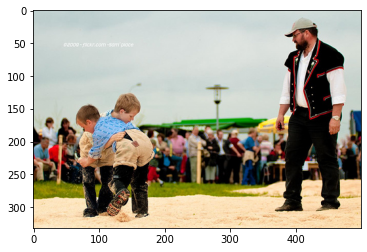

Real Caption: two boys wrestling in the sand while man looks on
Prediction Caption: two kids wrestle as man observes
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


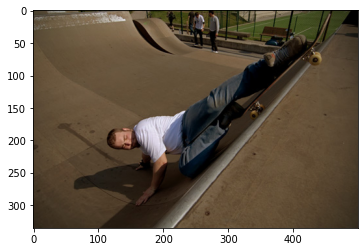

Real Caption: the man is wearing white shirt and blue jeans on skateboard
Prediction Caption: man wearing white shirt and blue jeans falling down on skateboarding ramp
BLEU-1 score: 61.53846153846154
BLEU-2 score: 50.63696835418333
BLEU-3 score: 49.07731670784565
BLEU-4 score: 40.89601472043678
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


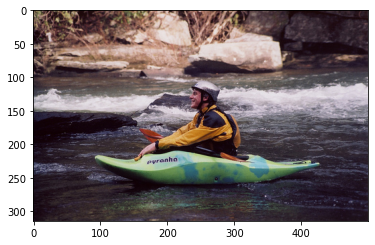

Real Caption: man in small kayak is floating down the river
Prediction Caption: man smiles in the river
BLEU-1 score: 40.43537731417556
BLEU-2 score: 22.147368276206617
BLEU-3 score: 1.6770179435990235e-91
BLEU-4 score: 5.467133248249544e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


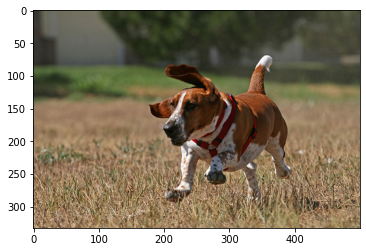

Real Caption: <unk> dog running in the grass
Prediction Caption: brown and white dog is running through dry field ears flapping
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


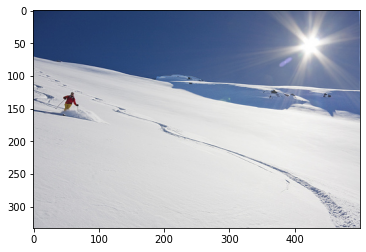

Real Caption: skier is skiing alone in fresh powder on sunny day
Prediction Caption: skier traveling downhill through mostly snow slope
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


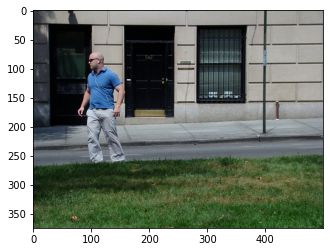

Real Caption: bald man in blue polo shirt stands next to brick building
Prediction Caption: man in blue shirt is running outside of an empty street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


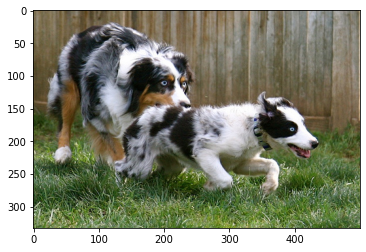

Real Caption: small black and white dog is followed by larger dog in grassy yard
Prediction Caption: three puppy and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white
BLEU-1 score: 6.060606060606061
BLEU-2 score: 4.351941398892446
BLEU-3 score: 7.71637193255361e-92
BLEU-4 score: 3.111814750339667e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


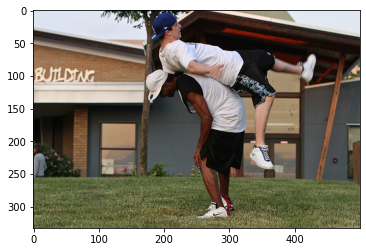

Real Caption: man holding up another with his back
Prediction Caption: two people with backpacks
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


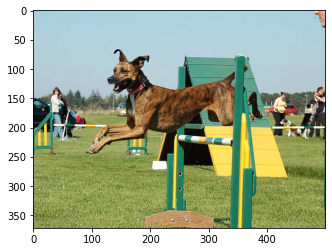

Real Caption: brown dog jumping over hurdle
Prediction Caption: dog jumps over hurdle
BLEU-1 score: 60.0
BLEU-2 score: 38.72983346207417
BLEU-3 score: 2.864380491069489e-91
BLEU-4 score: 9.283142785759642e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


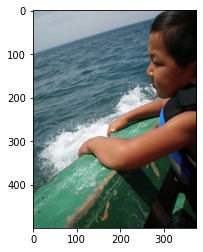

Real Caption: child holds on to the side of small weathered green watercraft on the open sea
Prediction Caption: young boy wearing life jacket is on green wooden boat of his boat
BLEU-1 score: 19.951345279371914
BLEU-2 score: 6.429064617453812e-153
BLEU-3 score: 1.5020472348657177e-183
BLEU-4 score: 1.1540791471212466e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


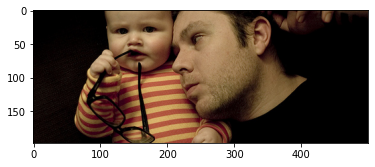

Real Caption: man holding baby who is holding black glasses
Prediction Caption: baby with lot of to the other
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


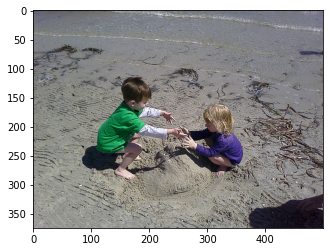

Real Caption: little girl and boy play in the sand on the beach
Prediction Caption: child and girl on path
BLEU-1 score: 21.729910425353914
BLEU-2 score: 4.5840057067137364e-153
BLEU-3 score: 9.040357228341029e-184
BLEU-4 score: 6.657922819542466e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


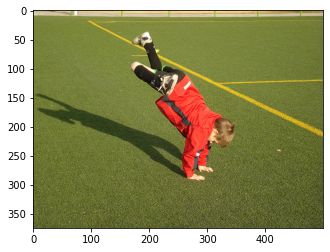

Real Caption: child in red jacket doing handstand on green grass
Prediction Caption: the girl in red uniform is jumping up above the grass
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


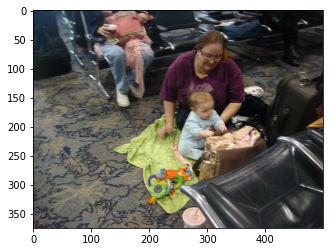

Real Caption: woman and baby waiting at an airport
Prediction Caption: near seats woman sits in blanket
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


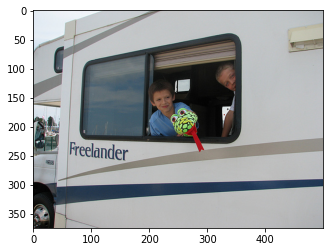

Real Caption: two boys looking out the window of an rv
Prediction Caption: two young boys lean out the window of white rv with their stuffed toy snake
BLEU-1 score: 43.75
BLEU-2 score: 29.58039891549808
BLEU-3 score: 26.857958838184388
BLEU-4 score: 17.60928267911618
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


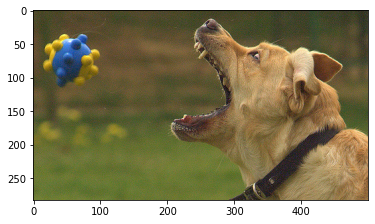

Real Caption: brown dog has its mouth open waiting to catch blue and yellow toy
Prediction Caption: dog opens its mouth to catch yellow toy
BLEU-1 score: 49.86958576677425
BLEU-2 score: 34.62769865265806
BLEU-3 score: 2.242072227831997e-91
BLEU-4 score: 7.028686056611379e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


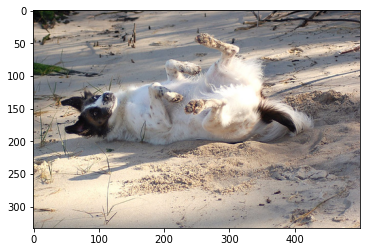

Real Caption: the dog rolls over to <unk> its back in the sand
Prediction Caption: dog rolls on the beach
BLEU-1 score: 21.729910425353914
BLEU-2 score: 13.743202059111331
BLEU-3 score: 1.1022783086561772e-91
BLEU-4 score: 3.645525559050358e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


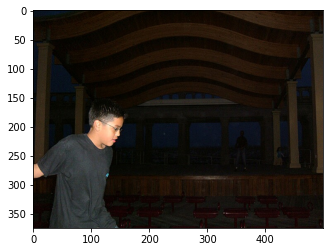

Real Caption: boy in black shirt is inside structure with wooden ceiling beams
Prediction Caption: young man in front of large curved archway
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


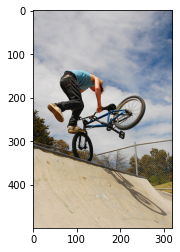

Real Caption: man is performing trick with bicycle on ramp
Prediction Caption: person does tricks on their bike
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


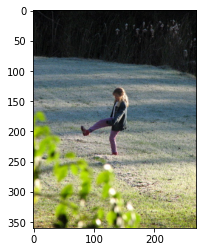

Real Caption: girl with her leg out on lawn
Prediction Caption: person looks from the shore of the surface of the surface of the surface of the surface of the surface of the surface of the surface of the surface of the surface
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


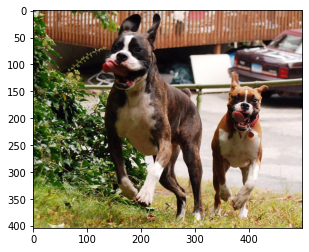

Real Caption: two brown and white dogs are next to each other with red toys in their mouths
Prediction Caption: two dogs running up grassy path
BLEU-1 score: 7.898658475130412
BLEU-2 score: 2.2042435261229696e-153
BLEU-3 score: 4.861917956276235e-184
BLEU-4 score: 3.682245099646241e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


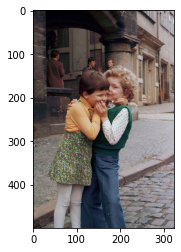

Real Caption: two young children playing on the street
Prediction Caption: little boy kisses little girl on the side of the road
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


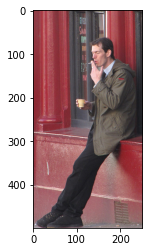

Real Caption: man sits by red building while smoking
Prediction Caption: man sits on red building smoking cigarette in his right hand
BLEU-1 score: 41.66666666666667
BLEU-2 score: 27.524094128159014
BLEU-3 score: 2.3336254371206134e-91
BLEU-4 score: 7.825799788115097e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


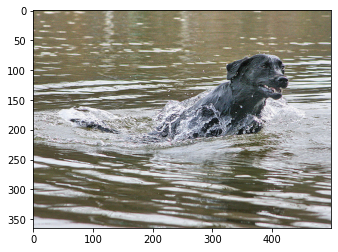

Real Caption: black dog swimming through river
Prediction Caption: black dog swimming through the water
BLEU-1 score: 57.14285714285714
BLEU-2 score: 53.45224838248488
BLEU-3 score: 52.16720683261119
BLEU-4 score: 41.113361690051974
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


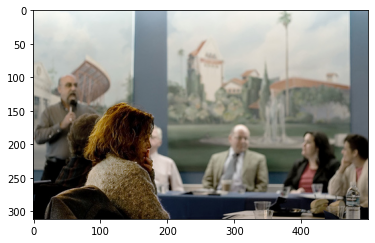

Real Caption: group of people are listening to man with moustache speak into microphone
Prediction Caption: woman sits alone while man sits alone while man sits alone while man sits alone while man sits alone while man sits alone while man sits alone while man sits alone while
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


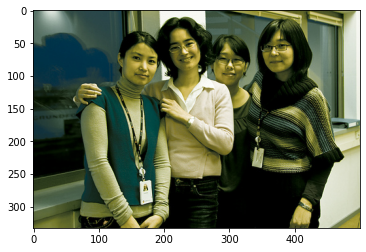

Real Caption: four asian women pose for picture
Prediction Caption: four women pose for picture with their picture taken
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 38.54221125344267
BLEU-4 score: 27.776190340117914
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


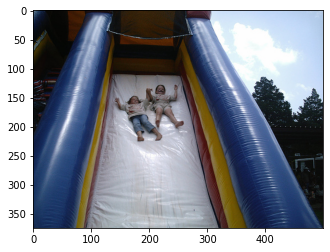

Real Caption: two girls slide down the slide
Prediction Caption: two children holding hands down giant inflatable slide
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


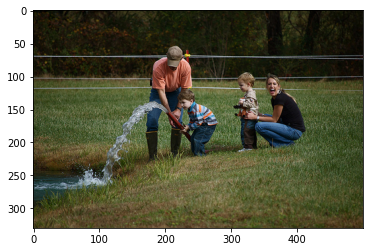

Real Caption: young child plays with hose in field with another child and two adults
Prediction Caption: two boys are playing with water with her boy squirt water while someone arm at his held by girl while holding baseball while holding cap holding an orange shirt is helping boy
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


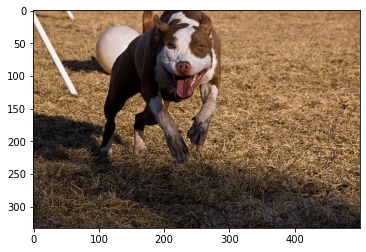

Real Caption: brown and white dog is running through dead grass
Prediction Caption: brown and white dog is leaping through the hair
BLEU-1 score: 60.0
BLEU-2 score: 51.63977794943222
BLEU-3 score: 50.11872336272722
BLEU-4 score: 41.11336169005197
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


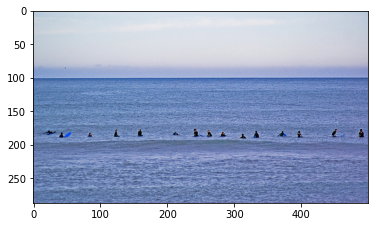

Real Caption: people line up in the ocean
Prediction Caption: surfers line of surfers stand on their surfboards in the water awaiting the next wave
BLEU-1 score: 18.75
BLEU-2 score: 11.18033988749895
BLEU-3 score: 1.3591779906380471e-91
BLEU-4 score: 4.98769305520104e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


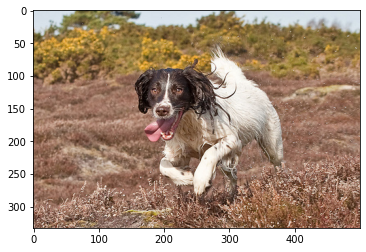

Real Caption: wet dog running in dry field
Prediction Caption: the white and white dog is running around in its mouth
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


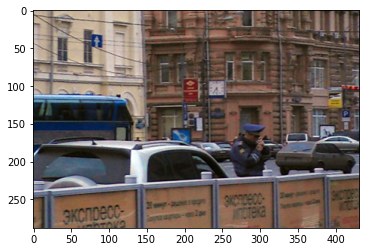

Real Caption: policeman stands in front of an suv
Prediction Caption: police officer is lighting cigarette
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


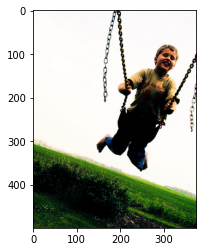

Real Caption: boy swings on swing set
Prediction Caption: young kid diving swing
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


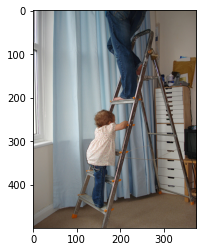

Real Caption: person stands at the top of ladder as young girl begins to climb
Prediction Caption: little girl is climbing ladder and child jumps up the the snow
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


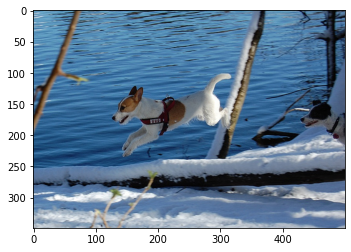

Real Caption: white dog with tan spot leaping over snow covered object with white and black dog behind
Prediction Caption: dog is leaping over fence with stick in the snow
BLEU-1 score: 28.851655406376448
BLEU-2 score: 13.532625921506297
BLEU-3 score: 1.2707787457946536e-91
BLEU-4 score: 4.3717967493328673e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


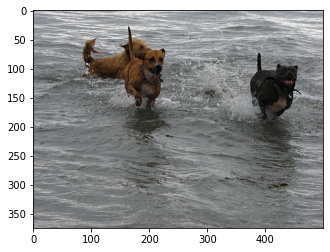

Real Caption: three dogs are running through the water
Prediction Caption: three dogs run through water
BLEU-1 score: 56.4321149927076
BLEU-2 score: 30.909142349231438
BLEU-3 score: 2.34046707917912e-91
BLEU-4 score: 7.629999090858336e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


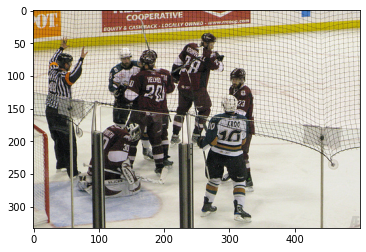

Real Caption: group of hockey players and one official stand on the ice during game
Prediction Caption: there is an ice hockey game with players and ref near one of the
BLEU-1 score: 53.333333333333336
BLEU-2 score: 19.51800145897066
BLEU-3 score: 1.898735791949771e-91
BLEU-4 score: 6.5900678916581e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


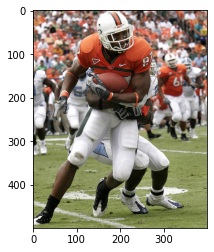

Real Caption: football player in an orange jersey tries to escape with the ball from the tackler
Prediction Caption: football players in orange with the ball in his head
BLEU-1 score: 37.91694154902975
BLEU-2 score: 22.95984830144277
BLEU-3 score: 18.498586695894577
BLEU-4 score: 2.817068157023372e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


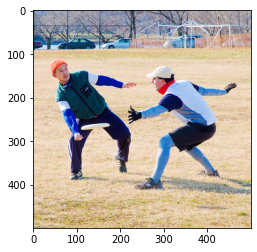

Real Caption: two men in wintry athletic clothing play ultimate frisbee
Prediction Caption: two men are playing frisbee in the park
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


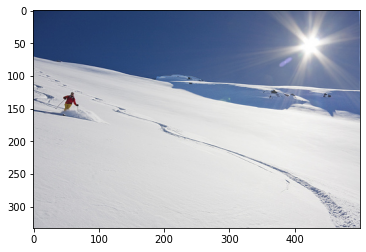

Real Caption: skier is skiing alone in fresh powder on sunny day
Prediction Caption: skier traveling downhill through mostly snow slope
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


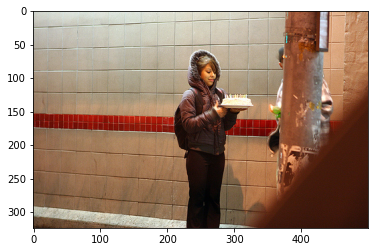

Real Caption: girl in hooded jacket presents cake with candles
Prediction Caption: woman playing violin and against the and another child in
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


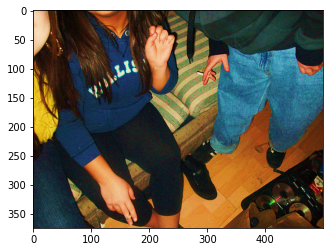

Real Caption: hands and feet of several people holding cigarettes
Prediction Caption: no faces and sweatshirts
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


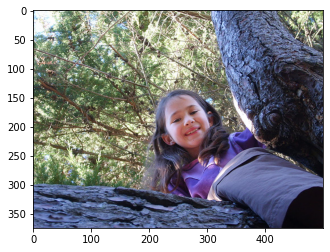

Real Caption: little brown haired girl up in tree
Prediction Caption: girl pokes her face bandanna pokes her face bandanna pokes her face bandanna pokes her face bandanna pokes her face bandanna pokes her face bandanna pokes her face bandanna pokes her face
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


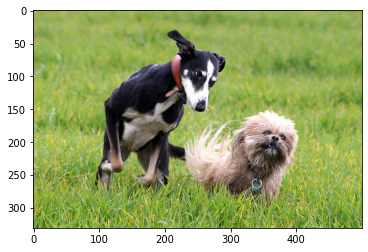

Real Caption: black dog chasing brown one
Prediction Caption: brown and white dog is running through field
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


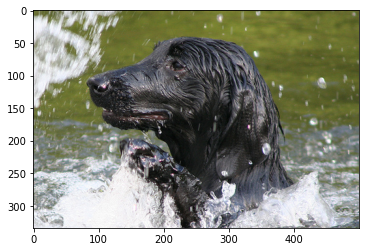

Real Caption: drenched black labrador in the water
Prediction Caption: black dog plays in murky water
BLEU-1 score: 42.857142857142854
BLEU-2 score: 9.765260274142007e-153
BLEU-3 score: 1.9861572195732883e-183
BLEU-4 score: 1.4740564900137074e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


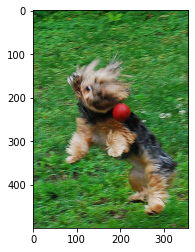

Real Caption: yorkie trying to catch red toy
Prediction Caption: little dog is jumping up at the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


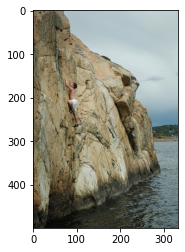

Real Caption: man climbs up the side of steep rock that overlooks river
Prediction Caption: man is climbing the side of mountain over the ocean
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


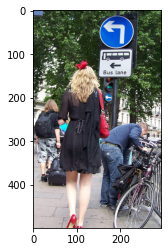

Real Caption: woman in black dress with red accessories is walking down the street
Prediction Caption: several people one girl in black dress is standing in the middle of bicycle
BLEU-1 score: 33.33333333333333
BLEU-2 score: 21.821789023599234
BLEU-3 score: 18.5845138912132
BLEU-4 score: 3.0046607657263396e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


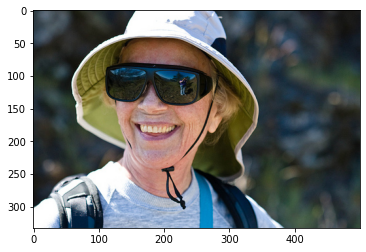

Real Caption: an older woman in hiking clothing and summer hat smiles
Prediction Caption: woman with hat wearing blue polo shirt wearing blue polo shirt wearing blue polo shirt wearing blue polo shirt wearing blue polo shirt wearing blue polo shirt wearing blue polo shirt wearing
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


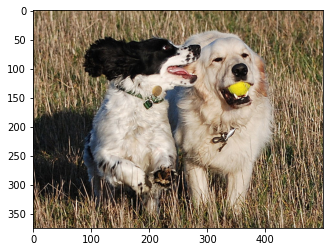

Real Caption: two dogs one holding ball
Prediction Caption: dog is carrying stick
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


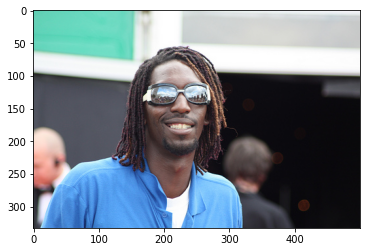

Real Caption: man with <unk> wearing large black sunglasses
Prediction Caption: man in sunglasses and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and shirt and
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


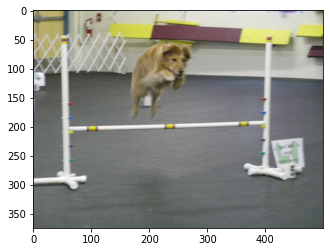

Real Caption: dog jumping pole
Prediction Caption: light brown dog jumps over low logs
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


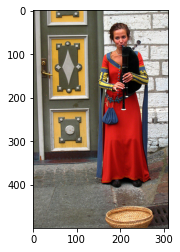

Real Caption: lady wearing red dress is playing bagpipe
Prediction Caption: woman in little girl in knit costume <unk> little girl wearing red dress playing bagpipe
BLEU-1 score: 31.25
BLEU-2 score: 25.0
BLEU-3 score: 19.720848397439248
BLEU-4 score: 3.1569965207666667e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


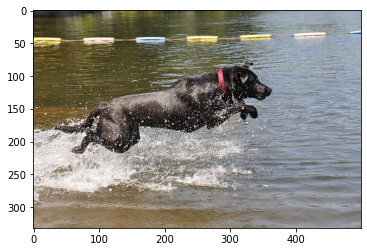

Real Caption: black dog with red collar is jumping in the water
Prediction Caption: black dog with red collar is jumping out of the water
BLEU-1 score: 75.0
BLEU-2 score: 69.08492797077574
BLEU-3 score: 65.06103783996204
BLEU-4 score: 57.06745777055999
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


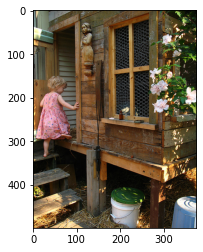

Real Caption: child in pink dress is climbing up set of stairs in an <unk> way
Prediction Caption: girl going into the air
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


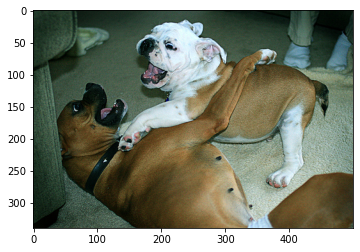

Real Caption: two dogs wrestle
Prediction Caption: two dogs are playing and wrestling on the carpet
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


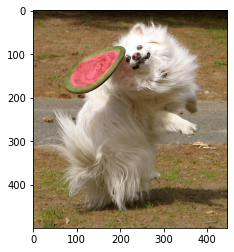

Real Caption: frisbee casts shadow on the dog
Prediction Caption: white dog with long hair jumps into long grass
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


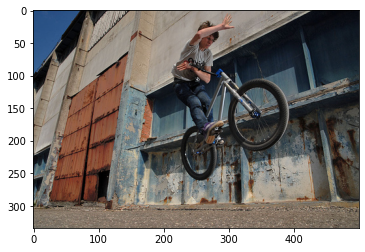

Real Caption: boy is doing jumping stunt on bicycle in run down street
Prediction Caption: boy is in the air on his bike
BLEU-1 score: 35.588329018524796
BLEU-2 score: 18.873561585072657
BLEU-3 score: 1.702596330404034e-91
BLEU-4 score: 5.798881106377341e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


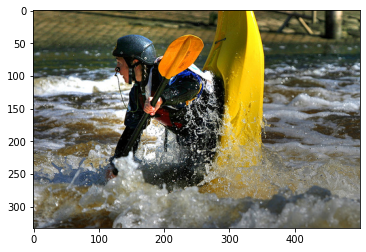

Real Caption: kayaker <unk> into the river
Prediction Caption: man in yellow life jacket in rough water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


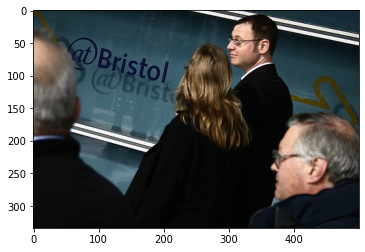

Real Caption: man in black suit looking toward woman with long hair
Prediction Caption: group of men in dark black and woman walk
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


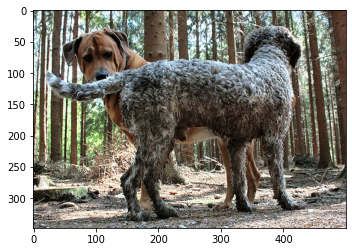

Real Caption: two medium size dogs <unk> each others <unk>
Prediction Caption: two dogs in the middle of chain link fence
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


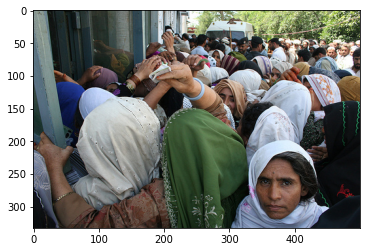

Real Caption: the crowds are huge as the <unk> await the opening
Prediction Caption: many people are in headwraps
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


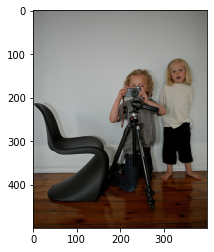

Real Caption: little girl is standing next to another little girl who is taking photograph
Prediction Caption: child uses camera in the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


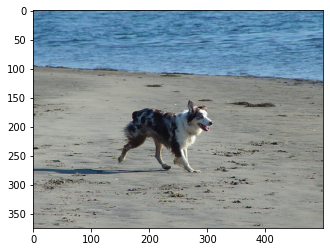

Real Caption: dog walks along beach
Prediction Caption: dog walks on the sand along the water
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


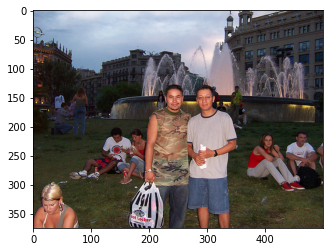

Real Caption: two men are posing for photograph in front of fountain in city
Prediction Caption: man and woman in an older is standing in front of fountain while other men sit and kissing in front of fountain while other men sit and kissing in front of fountain
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.055824196677337
BLEU-3 score: 12.953378820576026
BLEU-4 score: 7.781062585666583
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


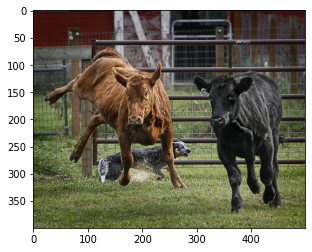

Real Caption: black cow and brown cow being chased by dog
Prediction Caption: brown cow runs in grassy field
BLEU-1 score: 21.470779802151025
BLEU-2 score: 16.39857894551434
BLEU-3 score: 1.5256446952908055e-91
BLEU-4 score: 5.236405306969006e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


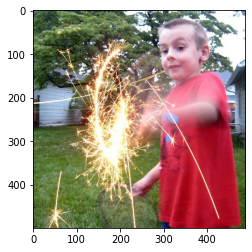

Real Caption: boy waves around sparkler
Prediction Caption: child in red shirt plays with fireworks
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


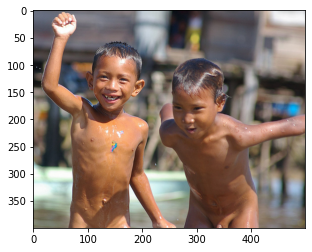

Real Caption: two naked young boys play in the water
Prediction Caption: two young naked young naked boys one with mark on his chest
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


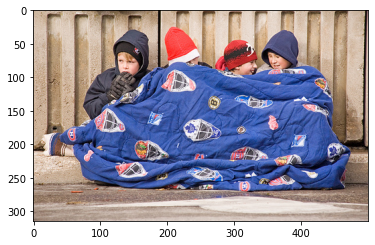

Real Caption: four children keeping warm under blanket
Prediction Caption: four children are sitting outside
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


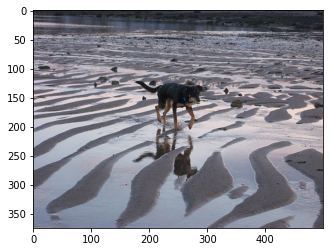

Real Caption: brown and black dog running on shore near the beach
Prediction Caption: black and black dog is walking over shoreline with many small sand hills
BLEU-1 score: 21.428571428571423
BLEU-2 score: 18.15682598006407
BLEU-3 score: 17.047848800266543
BLEU-4 score: 2.7961519085384024e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


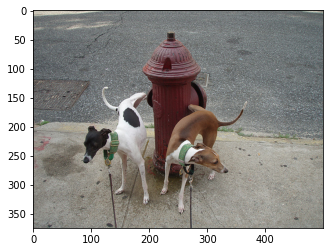

Real Caption: two dogs peeing on fire hydrant
Prediction Caption: two dogs are peeing at each other black and black dog on the fire hydrant
BLEU-1 score: 37.5
BLEU-2 score: 22.360679774997898
BLEU-3 score: 2.0601285972463702e-91
BLEU-4 score: 7.053663163619217e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


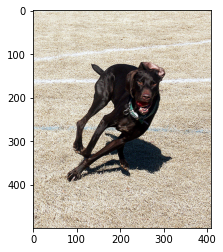

Real Caption: black dog is running very fast on light brown ground
Prediction Caption: dog running outside
BLEU-1 score: 11.156508007421492
BLEU-2 score: 2.3535070035699276e-153
BLEU-3 score: 4.641474163200319e-184
BLEU-4 score: 3.4182915527508447e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


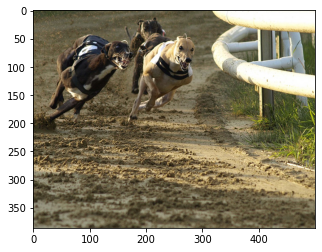

Real Caption: three dogs racing <unk> around racetrack
Prediction Caption: white greyhound dogs running race
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


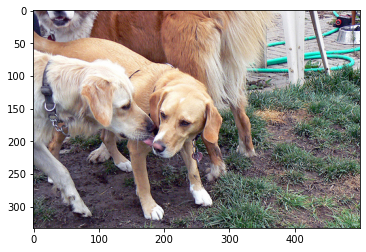

Real Caption: three tan dogs are outside one licks the other nose
Prediction Caption: two dogs are nose to nose while third dog stands next to them
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


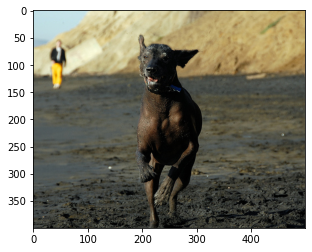

Real Caption: black dog runs through the black mud
Prediction Caption: dog runs on wet sand as it jumping off water
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


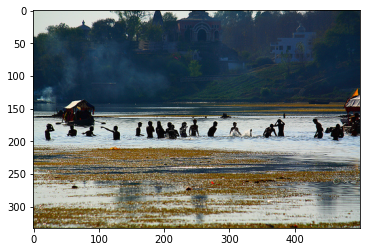

Real Caption: group of people are in the water
Prediction Caption: many people swimming is lake surrounded by trees and houses
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


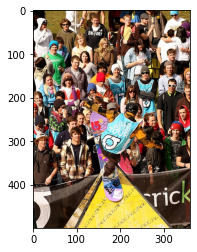

Real Caption: skateboarder performs trick in front of large crowd
Prediction Caption: spectators wearing yellow looks on yellow ramp
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


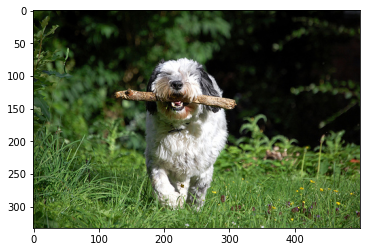

Real Caption: the dog runs through the grass carrying stick in its mouth
Prediction Caption: dog is carrying stick through the grass
BLEU-1 score: 51.546695909322914
BLEU-2 score: 38.965639509468254
BLEU-3 score: 28.564033753559343
BLEU-4 score: 4.038396753241122e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


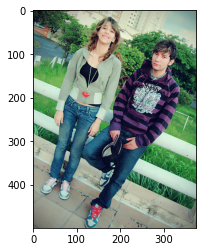

Real Caption: boy and girl both in jeans are standing in front of fence
Prediction Caption: smiling woman wearing black striped shirt is wearing green shirt is wearing green shirt is wearing green shirt is wearing green shirt is wearing green shirt is wearing green shirt is wearing
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


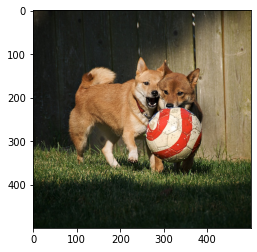

Real Caption: two dogs are playing with red and white ball
Prediction Caption: two small dogs chasing red striped grass
BLEU-1 score: 33.09363384692233
BLEU-2 score: 8.061224930331203e-153
BLEU-3 score: 1.683950142240867e-183
BLEU-4 score: 1.258141043412406e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


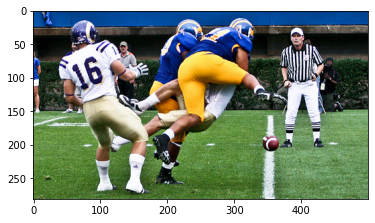

Real Caption: two football players are tackling third while referee watches
Prediction Caption: football player in blue and gold uniform
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


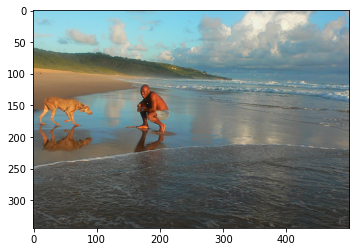

Real Caption: black man and his dog on the beach
Prediction Caption: man and dog standing on the beach
BLEU-1 score: 75.0
BLEU-2 score: 56.69467095138408
BLEU-3 score: 41.560423878293356
BLEU-4 score: 5.87583260478785e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


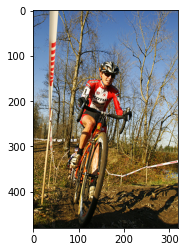

Real Caption: bicyclist riding on dirt race course
Prediction Caption: man in red on bike on dirt path
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


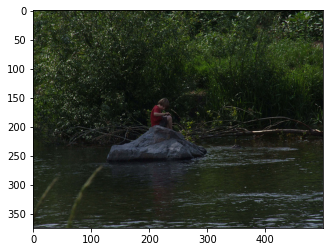

Real Caption: child wearing red shirt sits on rock in the water
Prediction Caption: girl sitting on rock in the middle of body of water
BLEU-1 score: 41.66666666666667
BLEU-2 score: 33.7099931231621
BLEU-3 score: 32.133956175406574
BLEU-4 score: 22.416933501922294
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


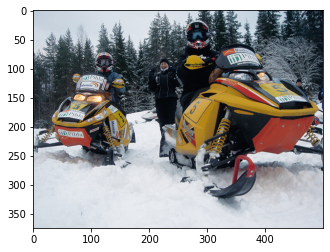

Real Caption: three people and two snowmobiles
Prediction Caption: two people are riding in orange life jackets riding snowmobiles
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


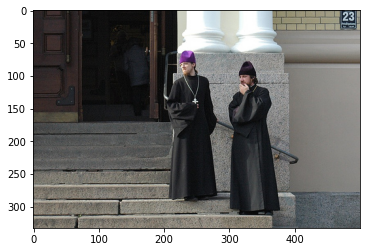

Real Caption: two young men stand on the steps in front of building
Prediction Caption: two religious men glancing off to their right while standing in front of church
BLEU-1 score: 33.33333333333333
BLEU-2 score: 21.821789023599234
BLEU-3 score: 18.5845138912132
BLEU-4 score: 3.0046607657263396e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


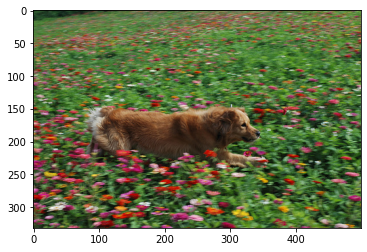

Real Caption: the brown dog walks through the flowers
Prediction Caption: brown dog is carrying colorful flowers
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


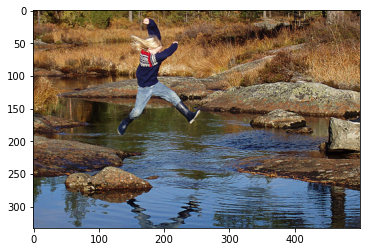

Real Caption: girl jumping from one rock to another in creek
Prediction Caption: girl hops across the river
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


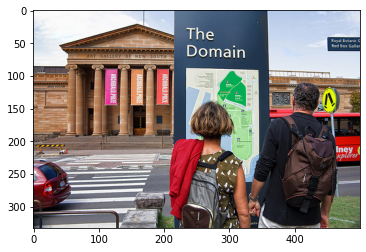

Real Caption: two people read sign in front of museum
Prediction Caption: tourists examine sign
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


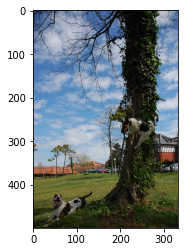

Real Caption: two dogs play by tree
Prediction Caption: two men are playing in the tree while in the tree while in the tree while in the tree while in the tree while in the tree while in the tree while
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


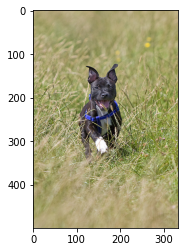

Real Caption: black dog with blue collar runs through the green grass
Prediction Caption: black and white dog in field
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


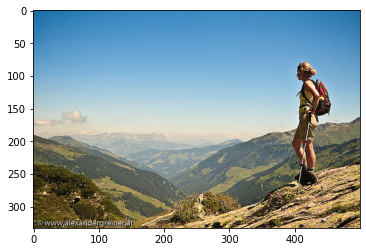

Real Caption: woman hiker stopped at the top of mountain with beautiful view
Prediction Caption: woman is standing on the edge of hill looking at the
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


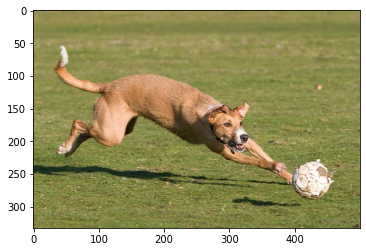

Real Caption: brown dog is chasing tattered soccer ball across low cut field
Prediction Caption: brown dog chasing ball
BLEU-1 score: 24.09553695297616
BLEU-2 score: 13.469814645303213
BLEU-3 score: 9.405003247338848e-92
BLEU-4 score: 3.004528558042487e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


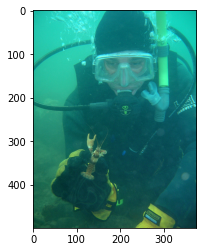

Real Caption: person in scuba suit holds very small lobster
Prediction Caption: scuba diver is paddling and green and green and green and green and green and green and green and green and green and green and green and green and green and green
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


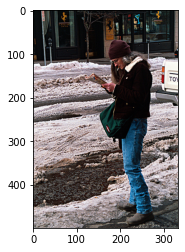

Real Caption: woman smoking cigarette is standing next to the road during wintery day
Prediction Caption: person in black clothes is reading and smoking on the sidewalk by road covered street
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


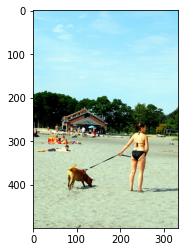

Real Caption: woman is standing at the beach with her dog on leash
Prediction Caption: woman walks dog on beach
BLEU-1 score: 28.973213900471883
BLEU-2 score: 15.869282816710692
BLEU-3 score: 1.2016358649827694e-91
BLEU-4 score: 3.917372151449784e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


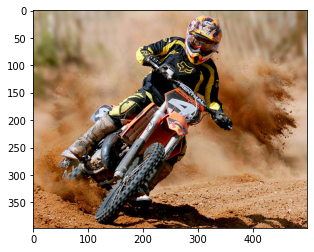

Real Caption: dirt bike takes turn
Prediction Caption: person rides dirt bike
BLEU-1 score: 40.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


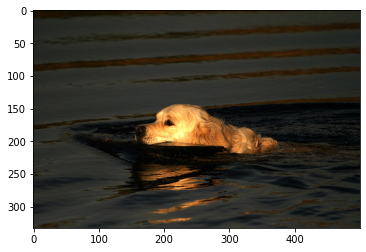

Real Caption: dog swims while carrying stick in its mouth
Prediction Caption: dog with golden hair swims through water
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


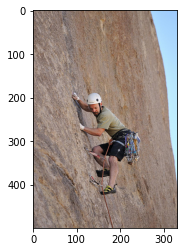

Real Caption: man in white helmet clings to sheer rock face
Prediction Caption: man is rock climbing
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


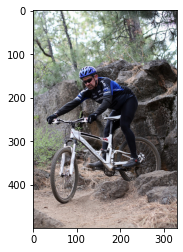

Real Caption: man in aerodynamic gear riding professional mountain bike through forest
Prediction Caption: man on mountain bike outdoors
BLEU-1 score: 25.6708559516296
BLEU-2 score: 16.23567485864776
BLEU-3 score: 1.3021879578069072e-91
BLEU-4 score: 4.3066795795519947e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


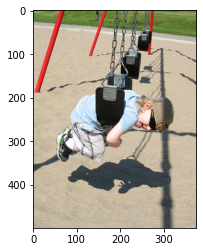

Real Caption: boy plays on the swing
Prediction Caption: boy laying on skateboard swing
BLEU-1 score: 50.0
BLEU-2 score: 1.0547686614863434e-152
BLEU-3 score: 2.0801644027471386e-183
BLEU-4 score: 1.5319719891192392e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


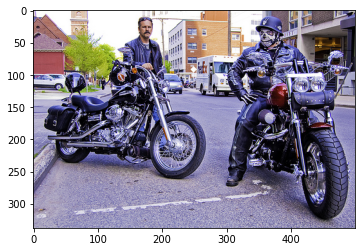

Real Caption: two motorcyclists are standing on the side of the road and one is wearing skull mask
Prediction Caption: motorcycle daredevil making turn
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


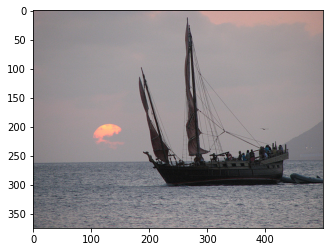

Real Caption: sailboat in the water
Prediction Caption: sailboat in the water at the rising sun
BLEU-1 score: 44.44444444444444
BLEU-2 score: 40.8248290463863
BLEU-3 score: 40.11753235797363
BLEU-4 score: 29.847458960098226
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


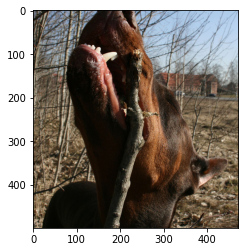

Real Caption: dog is biting twig
Prediction Caption: cat opens its mouth
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


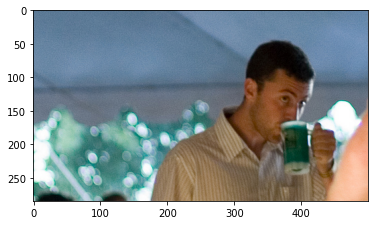

Real Caption: man in an oxford shirt drinks from beer mug in an large tent
Prediction Caption: man drinking green liquid from plastic mug
BLEU-1 score: 20.072303569462136
BLEU-2 score: 4.889380075085712e-153
BLEU-3 score: 1.021367390696536e-183
BLEU-4 score: 7.631011170724675e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


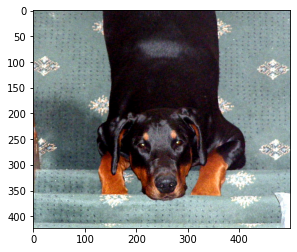

Real Caption: black dog looks up with his head on blue carpeted step
Prediction Caption: dog sits in the air near large container with their heads against another blonde hair looking through the air near large container
BLEU-1 score: 8.695652173913045
BLEU-2 score: 4.398689388311791e-153
BLEU-3 score: 1.23082782804226e-183
BLEU-4 score: 9.893133360884867e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


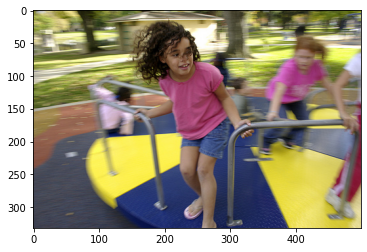

Real Caption: young girl at playground
Prediction Caption: little girl wearing pink shirt spins on at park
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


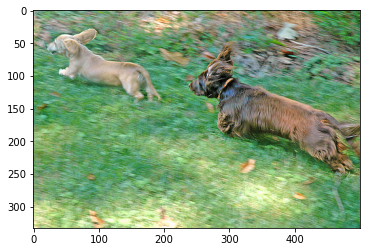

Real Caption: one dog chases another on the green grass
Prediction Caption: the large brown dog running through grassy yard
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


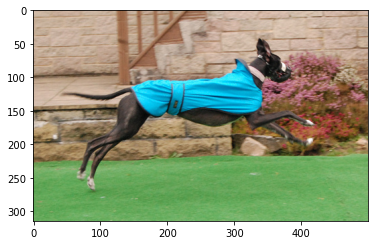

Real Caption: the black greyhound dog is running on the grass wearing blue jacket
Prediction Caption: the dog wearing blue shirt is jumping in the air
BLEU-1 score: 49.80549361539613
BLEU-2 score: 21.32543830616615
BLEU-3 score: 1.9308546502996532e-91
BLEU-4 score: 6.582343473345393e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


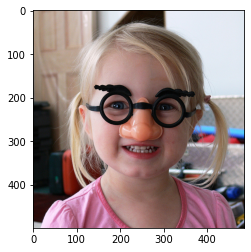

Real Caption: little girl is smiling whilst wearing fake nose and glasses
Prediction Caption: girl earring groucho marx glasses
BLEU-1 score: 17.113903967753068
BLEU-2 score: 4.421625271317475e-153
BLEU-3 score: 9.45672212180377e-184
BLEU-4 score: 7.107197028258988e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


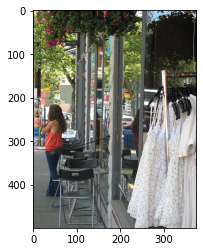

Real Caption: girl in an orange tank top stands outside cafe
Prediction Caption: girl wearing red top
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


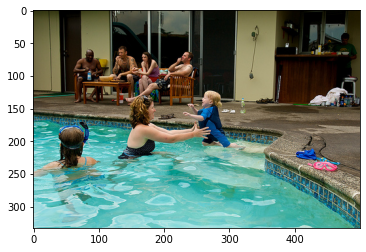

Real Caption: little girl jumps into the arms of her mother standing in pool
Prediction Caption: woman catches young boy jumping into pool
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


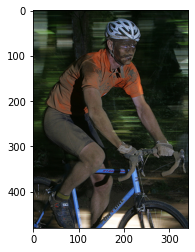

Real Caption: biker all covered in mud riding blue bike
Prediction Caption: the man in blue shirt and red shirt is on bike
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


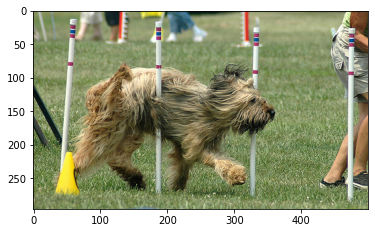

Real Caption: dog completing <unk> <unk>
Prediction Caption: shaggy brown dog is doing an obstacle
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


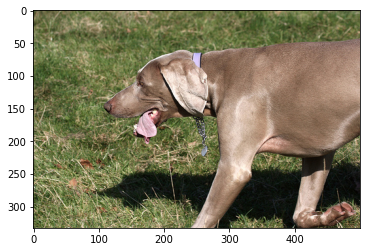

Real Caption: brown dog walks in the grass with its tongue hanging out
Prediction Caption: tan dog jogging with his tongue hanging out
BLEU-1 score: 44.485411273156004
BLEU-2 score: 29.841721084143686
BLEU-3 score: 24.703640248156642
BLEU-4 score: 3.670443885491954e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


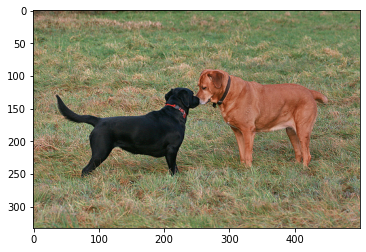

Real Caption: there are two dogs one is black and the other is brown sniffing each other
Prediction Caption: two dogs examine each other in grassy field
BLEU-1 score: 22.818538623670754
BLEU-2 score: 17.113903967753068
BLEU-3 score: 1.344005116346986e-91
BLEU-4 score: 4.421625271317475e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


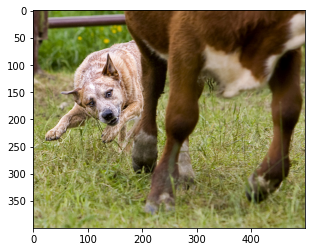

Real Caption: the large brown dog is playing in the grass with brown cow
Prediction Caption: two dogs outside with white dog stands nearby
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


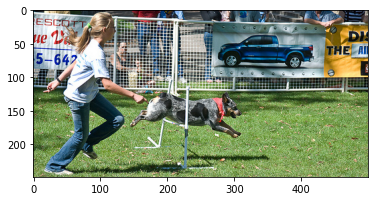

Real Caption: woman leading grey and black spotted dog in red bandanna through competition
Prediction Caption: woman runs alongside her dog as he jumps hurdle
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


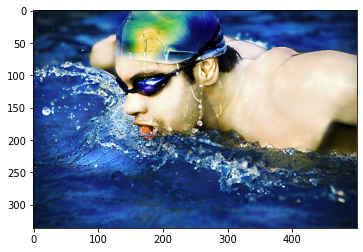

Real Caption: the swimmer is wearing green and yellow hat and goggles
Prediction Caption: swimmer paddles down as he slides into pool
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


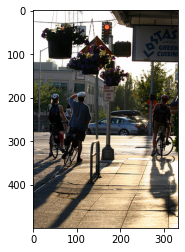

Real Caption: bicyclists waiting at an intersection
Prediction Caption: man walking down the ground
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


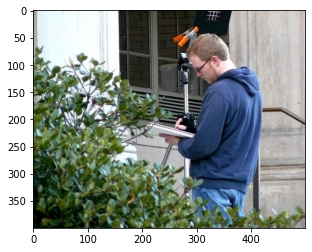

Real Caption: man wearing blue sweatshirt stands outside and writes in notebook
Prediction Caption: man wearing glasses is drawing
BLEU-1 score: 17.113903967753068
BLEU-2 score: 13.256373011140136
BLEU-3 score: 1.1530451067989366e-91
BLEU-4 score: 3.8915242969889024e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


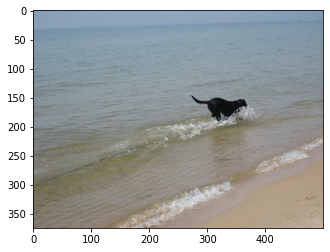

Real Caption: black dog running in shallow water on beach
Prediction Caption: black dog runs into the water at the beach
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


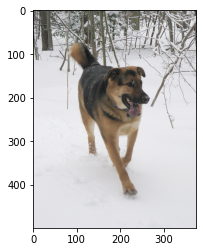

Real Caption: dog with its tongue out walking in the snow
Prediction Caption: brown dog runs on the white dog
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


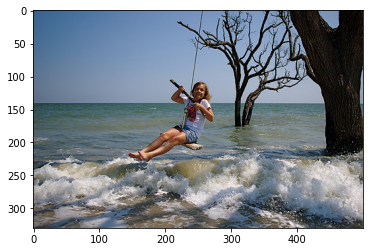

Real Caption: girl swinging from tree on rope over crashing waves
Prediction Caption: girl is on from lake
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


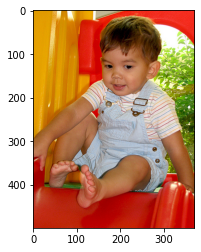

Real Caption: small child wearing light blue overalls sits on red slide
Prediction Caption: toddler in light blue overall sits at the top of red plastic slide
BLEU-1 score: 35.71428571428572
BLEU-2 score: 16.5748386032949
BLEU-3 score: 1.7213647859230602e-91
BLEU-4 score: 6.072910347203158e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


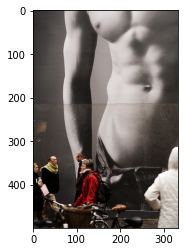

Real Caption: some people walk past large billboard
Prediction Caption: crowd of an elderly man is holding the through the back
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


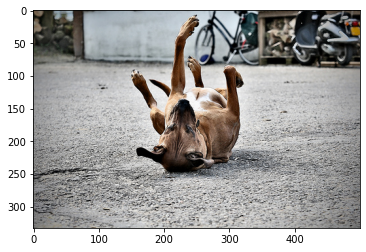

Real Caption: tan dog is rolling on his back on some asphalt with bike and scooter in the background
Prediction Caption: large brown dog laying on its back outside on blacktop with its legs in the air
BLEU-1 score: 41.17647058823529
BLEU-2 score: 16.0422236979937
BLEU-3 score: 1.6879596866881675e-91
BLEU-4 score: 5.974540365813253e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


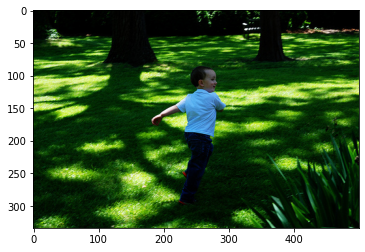

Real Caption: boy running through green grass
Prediction Caption: boy wearing blue shirt is running on his green grass running on the grass between the trees in the day
BLEU-1 score: 19.047619047619047
BLEU-2 score: 9.759000729485333
BLEU-3 score: 1.2526984489726636e-91
BLEU-4 score: 4.65988169467104e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


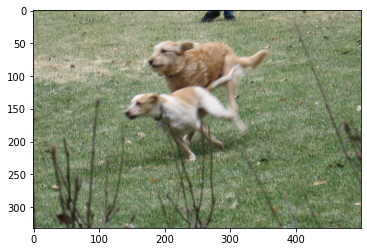

Real Caption: two brown dogs run through the grass
Prediction Caption: two dogs are running through the grass
BLEU-1 score: 62.5
BLEU-2 score: 42.25771273642582
BLEU-3 score: 34.84161012993529
BLEU-4 score: 5.072841446586652e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


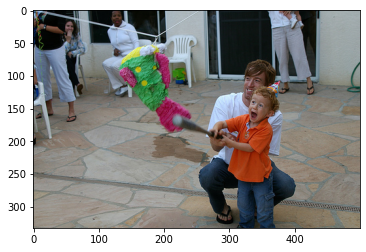

Real Caption: the small boy in an orange shirt gets some help from an adult while swinging at pinata
Prediction Caption: girl in an orange collared shirt is swinging baseball bat
BLEU-1 score: 26.344467217491342
BLEU-2 score: 17.474942612447386
BLEU-3 score: 14.602309271580285
BLEU-4 score: 2.2440855537289727e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


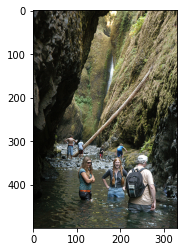

Real Caption: group of people are crossing river
Prediction Caption: several people wading in the water at the bottom of ravine
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


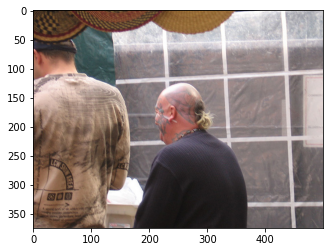

Real Caption: two men one of which is bald in bathroom
Prediction Caption: two men are standing in his mouth
BLEU-1 score: 33.09363384692233
BLEU-2 score: 20.42583425999594
BLEU-3 score: 1.8560791299878595e-91
BLEU-4 score: 6.33313451367699e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


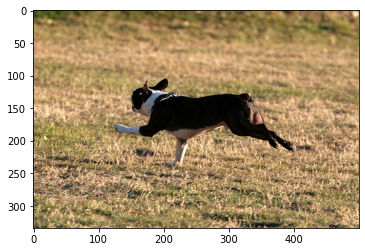

Real Caption: dog sprints across grassy field
Prediction Caption: dog running in the grass
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


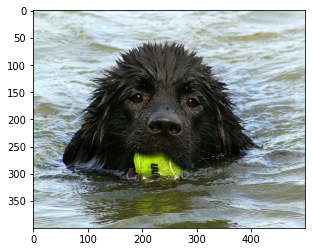

Real Caption: dog swims in the water with tennis ball in his mouth
Prediction Caption: black dog is swimming with ball in its mouth
BLEU-1 score: 45.241870901797974
BLEU-2 score: 21.327222472151792
BLEU-3 score: 1.923942683267341e-91
BLEU-4 score: 6.552765724042392e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


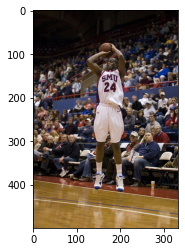

Real Caption: basketball player in white jumping to throw the ball audience in the back
Prediction Caption: basketball player shooting for the basketball
BLEU-1 score: 18.18740767186928
BLEU-2 score: 11.341841376953123
BLEU-3 score: 9.729992503385463e-92
BLEU-4 score: 3.272561325903966e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


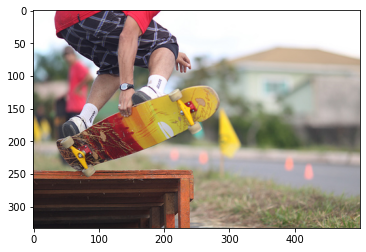

Real Caption: skateboarder ollies off ramp
Prediction Caption: skateboarder flies down the yellow ramp
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


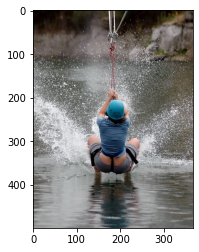

Real Caption: person in harness is hanging above water making spray with their feet
Prediction Caption: girl wearing harness is lifted out of the water
BLEU-1 score: 24.561922592339457
BLEU-2 score: 14.947910066133426
BLEU-3 score: 1.4935097310718617e-91
BLEU-4 score: 5.218347612900714e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


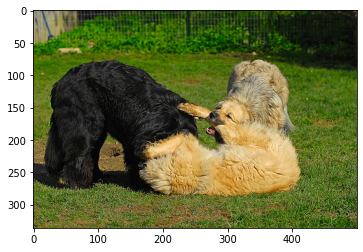

Real Caption: three dogs playing on grass
Prediction Caption: three dogs are playing with each other
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


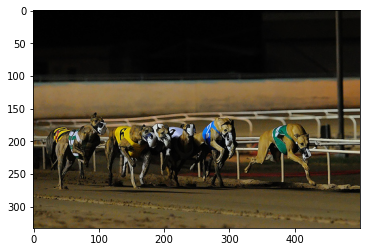

Real Caption: six dogs are competing in race
Prediction Caption: dogs racing around track
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


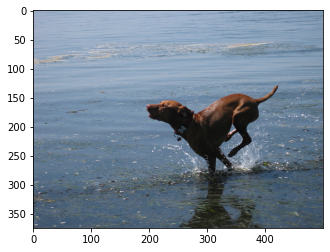

Real Caption: brown dog runs down beach
Prediction Caption: brown dog running through the water
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


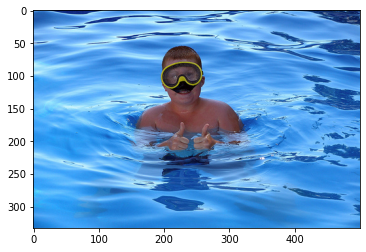

Real Caption: the boy in the water with the yellow goggles gives two thumbs up
Prediction Caption: boy wearing goggles gives swimming pool has goggles gives swimming pool has goggles gives swimming pool has goggles gives swimming pool has goggles gives swimming pool has goggles gives swimming pool has
BLEU-1 score: 9.09090909090909
BLEU-2 score: 5.33001790889026
BLEU-3 score: 8.714460994874503e-92
BLEU-4 score: 3.4437891216575777e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


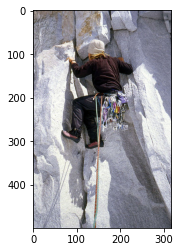

Real Caption: girl is climbing rock wall
Prediction Caption: rock climber ascends
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


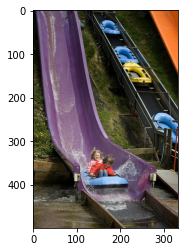

Real Caption: two little girls ride an inflatable dinghy down purple water slide
Prediction Caption: two children at the bottom of purple water slide
BLEU-1 score: 36.193496721438386
BLEU-2 score: 26.97703967085066
BLEU-3 score: 23.458368218182663
BLEU-4 score: 3.5879471085711125e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


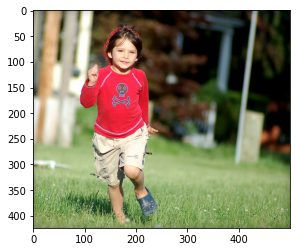

Real Caption: girl with red shirt is running in the grass
Prediction Caption: little boy in red shirt and blue crocs shoes runs toward the camera
BLEU-1 score: 28.57142857142857
BLEU-2 score: 14.824986333222023
BLEU-3 score: 1.6099037441710956e-91
BLEU-4 score: 5.74340400309589e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


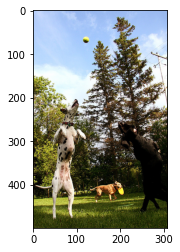

Real Caption: black and white dog are going after tennis ball
Prediction Caption: there is dog with frisbee and dog wrestle with ball and dog who has frisbee and dog watches
BLEU-1 score: 15.789473684210522
BLEU-2 score: 5.927288177094464e-153
BLEU-3 score: 1.4720309963537117e-183
BLEU-4 score: 1.1484186507842884e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


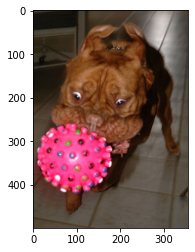

Real Caption: brown dog indoors with large pink toy
Prediction Caption: dog is playing with toy on large cookie
BLEU-1 score: 44.44444444444444
BLEU-2 score: 9.944454308267121e-153
BLEU-3 score: 2.0079454189758343e-183
BLEU-4 score: 1.4875195904069663e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


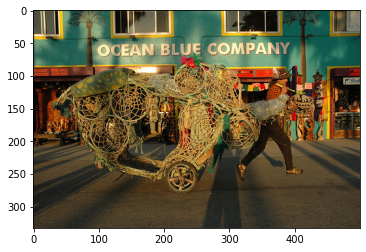

Real Caption: man pulling cart in the street
Prediction Caption: the people in the sun
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


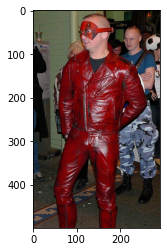

Real Caption: man in red suit and red mask stands beside another costumed man
Prediction Caption: man wearing red costume stands near others
BLEU-1 score: 22.744899739223754
BLEU-2 score: 5.540393468539137e-153
BLEU-3 score: 1.1573608787806806e-183
BLEU-4 score: 8.647068503442338e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


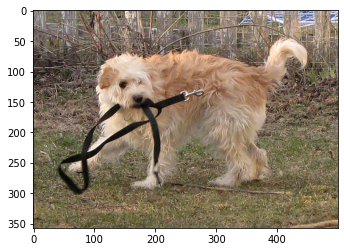

Real Caption: dog walking with his lease in his mouth
Prediction Caption: large dog carries black leash in its mouth
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


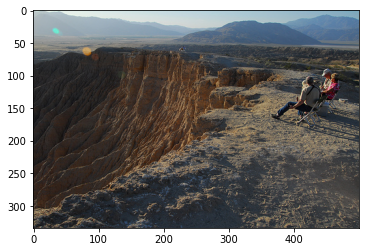

Real Caption: people in folding chairs take in the view from cliff
Prediction Caption: several people sitting on the edge of large cliff overlooking steep rocky mountain
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


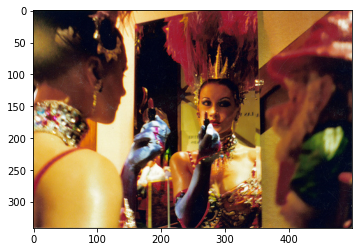

Real Caption: woman in fancy costume is <unk> her makeup in front of mirror
Prediction Caption: showgirl puts on his lipstick in something
BLEU-1 score: 7.581633246407919
BLEU-2 score: 3.1987476604776096e-153
BLEU-3 score: 8.324006713297918e-184
BLEU-4 score: 6.570351225189682e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


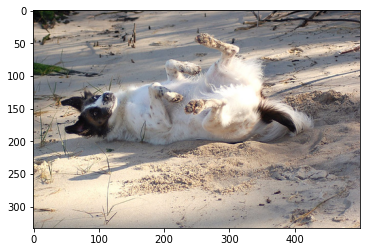

Real Caption: the dog rolls over to <unk> its back in the sand
Prediction Caption: dog rolls on the beach
BLEU-1 score: 21.729910425353914
BLEU-2 score: 13.743202059111331
BLEU-3 score: 1.1022783086561772e-91
BLEU-4 score: 3.645525559050358e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


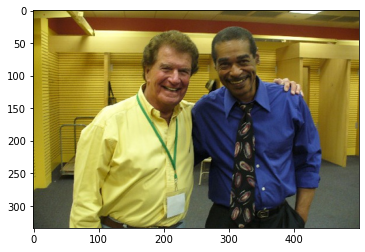

Real Caption: man in yellow and yellow shirt puts his arm around man in blue shirt
Prediction Caption: two guys one black and black and black and black and black and black and black and black and black and black and black and black and black and black and black
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


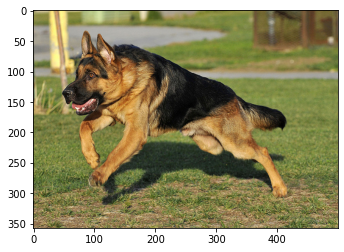

Real Caption: black and tan dog leaps over the green grass
Prediction Caption: brown and black dog running on the grass outdoors
BLEU-1 score: 50.0
BLEU-2 score: 1.0547686614863434e-152
BLEU-3 score: 2.0801644027471386e-183
BLEU-4 score: 1.5319719891192392e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


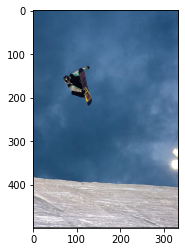

Real Caption: snowboarder suspended in the air
Prediction Caption: snowboarder launches into the air
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


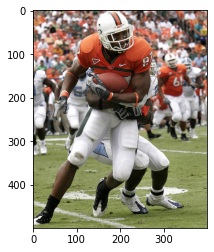

Real Caption: football player is getting tackled
Prediction Caption: football players in orange with the ball in his head
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


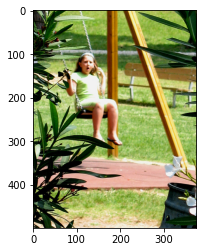

Real Caption: girl on swing in the park
Prediction Caption: girl sings on the swing
BLEU-1 score: 66.66666666666666
BLEU-2 score: 1.2179419412838124e-152
BLEU-3 score: 2.2676670054850645e-183
BLEU-4 score: 1.646211035903463e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


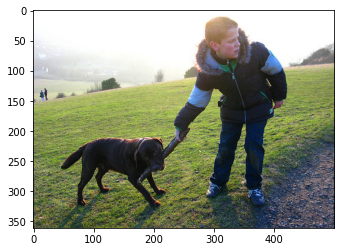

Real Caption: boy tries to take stick from small brown dog
Prediction Caption: the two boys on his face dog on grass carrying stick
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


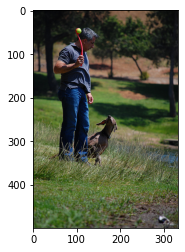

Real Caption: man has yellow ball on red stick
Prediction Caption: brown dog is throwing baseball into the field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


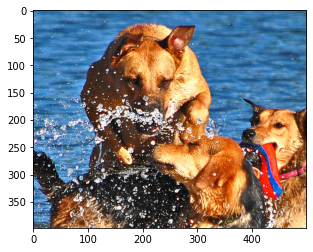

Real Caption: three brown dogs are playing in the sea
Prediction Caption: three brown and black dogs are splashing in the water
BLEU-1 score: 54.54545454545454
BLEU-2 score: 40.45199174779452
BLEU-3 score: 2.9401350227402655e-91
BLEU-4 score: 9.487289885028995e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


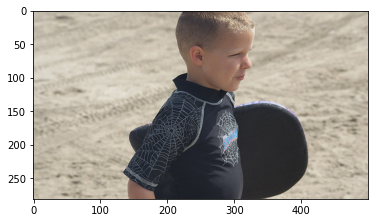

Real Caption: boy carries <unk> on the beach
Prediction Caption: woman appears to his on the sand
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


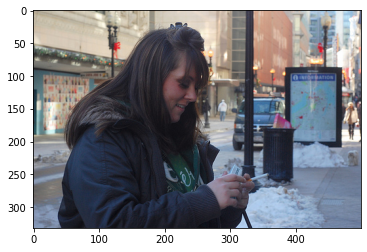

Real Caption: the woman is walking through the snow and trying to light cigarette
Prediction Caption: woman smoking cigarette outside in the snow
BLEU-1 score: 30.326532985631673
BLEU-2 score: 16.210213737276042
BLEU-3 score: 1.390649480096532e-91
BLEU-4 score: 4.6772756555248046e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


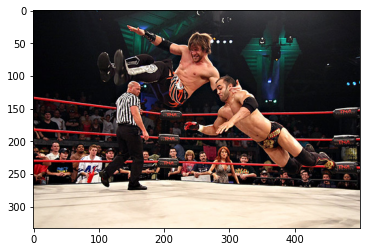

Real Caption: two wrestlers jump in ring while an official watches
Prediction Caption: two men in fight in ring
BLEU-1 score: 32.206169703226536
BLEU-2 score: 20.084075461628778
BLEU-3 score: 1.7229821612226873e-91
BLEU-4 score: 5.795035077445241e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


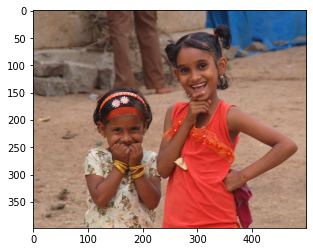

Real Caption: two young dark skinned girls are smiling and laughing
Prediction Caption: two young girls are smiling at the camera
BLEU-1 score: 55.55555555555556
BLEU-2 score: 45.64354645876384
BLEU-3 score: 34.84161012993529
BLEU-4 score: 5.072841446586652e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


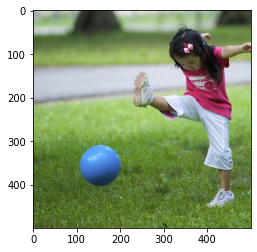

Real Caption: little girl in pink shirt kicks blue ball
Prediction Caption: little girl chasing purple ball
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


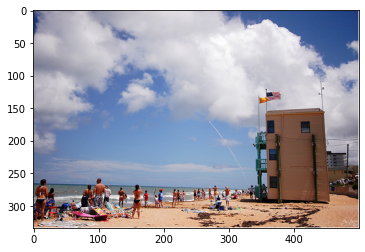

Real Caption: beachgoers watch something in the sky
Prediction Caption: busy beach has people on it watching the sky
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


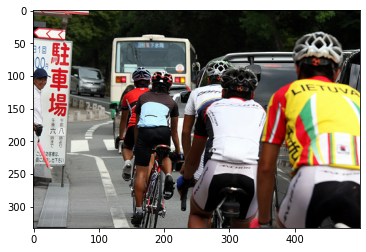

Real Caption: busy street full of cars and bike riders
Prediction Caption: five people on bikes in traffic with man watching from the side of the road
BLEU-1 score: 6.25
BLEU-2 score: 3.7291703656001405e-153
BLEU-3 score: 1.1147325022884998e-183
BLEU-4 score: 9.10915994722721e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


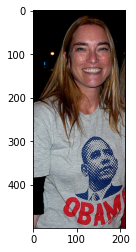

Real Caption: woman wearing that says obama
Prediction Caption: woman in obama smiling
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


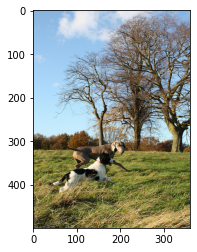

Real Caption: two dog with trees in the background
Prediction Caption: two dogs running on the grass in the grass
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


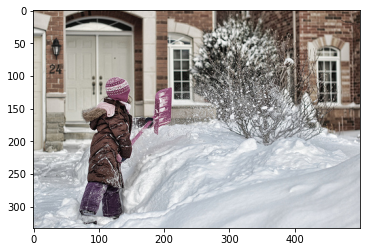

Real Caption: the child is shoveling deep white snow near the house
Prediction Caption: the girl wearing brown jacket whilst walking in snow
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


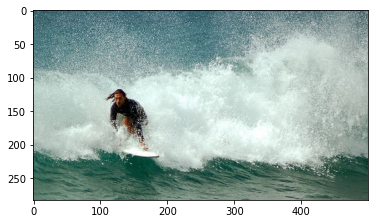

Real Caption: man riding surfboard on wave
Prediction Caption: man surfing in the ocean
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


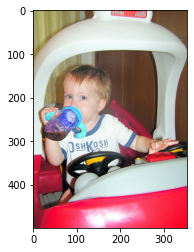

Real Caption: boy sits in toy car while drinking from his sippy cup
Prediction Caption: toddler in red mask forward from cup while wearing mask is pulling in red arcade ride
BLEU-1 score: 23.529411764705884
BLEU-2 score: 7.235653323902229e-153
BLEU-3 score: 1.6591665362080695e-183
BLEU-4 score: 1.268852357850863e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


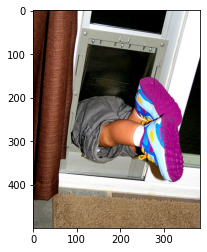

Real Caption: child legs while squeezing through dog door
Prediction Caption: child attempts to enter house through the doggy door
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


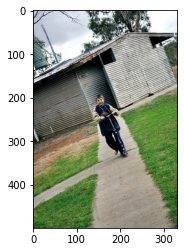

Real Caption: young boy rides his scooter on drive
Prediction Caption: the kid power path is running on the sidewalk
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


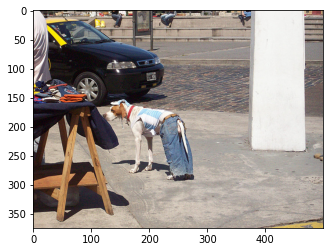

Real Caption: dog wears jeans
Prediction Caption: brown and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


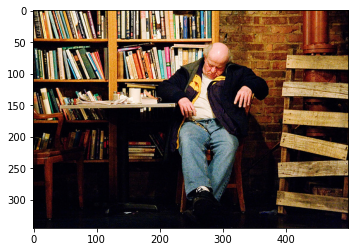

Real Caption: this bald man who appears to be asleep is sitting at table at library
Prediction Caption: an old man in an older lady is sleeping at table in front of book shelf
BLEU-1 score: 23.529411764705884
BLEU-2 score: 12.126781251816652
BLEU-3 score: 1.4270876757460378e-91
BLEU-4 score: 5.194514794593801e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


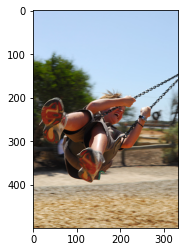

Real Caption: lady is swinging and smiling
Prediction Caption: person swinging on swing
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
BLEU-1 count: 198
BLEU-2 count: 101
BLEU-3 count: 32
BLEU-4 count: 10
BLEU-1 Total: 56.86426395808304
BLEU-2 Total: 24.57280882827449
BLEU-3 Total: 9.5450016355767
BLEU-4 Total: 3.2895911569124547
BLEU-1 Average: 0.28719325231355075
BLEU-2 Average: 0.2432951369136088
BLEU-3 Average: 0.29828130111177187
BLEU-4 Average: 0.3289591156912455
Real Caption: lady is swinging and smiling
Prediction Caption: person swinging on swing
Blue score count > 0.1 198
Blue score average >0.1 0.28719325231355075


In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):    
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]

    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    result, attention_plot = evaluate(image)

    # remove <start> and <end> from the real_caption
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    #Image.open(img_name_val[rid])
    #remove "<unk>" in result
    for i in result:
        if i=="<unk>":
            result.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result        
    result_join = ' '.join(result)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = result
    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")

    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)

    #plot_attention(image, result, attention_plot)
if blue_count_1 > 0:
    print("Blue score count > 0.1",blue_count_1)
    print("Blue score average >0.1",blue_1/blue_count_1)

In [ ]:
#-------------------END------------------------